# Micrograph analysis tutorial

This is a tutorial on how to use SimpliPyTEM to simplify the analysis of electron microscopy images. This includes basic functions including filtering, converting the file to 8-bit, looking at metadata and more.



## Import dependancies
The reason it says \<Figure size...\> is because I run plt.gray() which makes plt.imshow() show data in a grayscale image by default, this can be ignored. 

In [1]:
from SimpliPyTEM.Micrograph_class import * 

<Figure size 640x480 with 0 Axes>

## Initialise the Micrograph object and open a micrograph

The Micrograph object is the heart of SimpliPyTEM for images, this contains  the methods, data and metadata available with SimpliPyTEM. To use, initialise the object and then run one of the methods to open a file - open_dm for digital micrograph files, open_mrc for mrc files and open_tif for tif files. 

Note that if a video (or dose fractionation) dm file is provided, the micrograph object will automatically sum the frames, opening it as an image. To load video files as videos, use the MicroVideo object. 

An example image is included with this tutorial, and at times will be commented on itself, however you are very welcome to use your own image, hopefully very similar results will be seen.


In [2]:
#initialise micrograph object and open file
micrograph = Micrograph('Fibrils_Example.dm3')


Fibrils_Example.dm3 opened as a Micrograph object


### Opening standard image files

Alternatively .jpg, .png and .tif image files can also be loaded into the micrograph object using the function `.open_image()`. You can define the pixel size with the input. If it is a tif file, any metadata tags should be loaded into `micrograph.metadata_tags`, and can be viewed with `micrograph.show_metadata()`. The pixel size and unit may also be loaded from these tags, however the tags are not always the same so may not be loaded in. 

In [5]:
#   jpg_im = Micrograph('image.jpg')
#   png_im = Micrograph('image.png')
#   tif_im  = Micrograph('image.tif')



### Lets familiarise ourselves with the Micrograph object. 
This is a python object which contains the image data, metadata, and methods to handle the image. The most important thing is to access the image, this can be done through the command below:





In [4]:
micrograph.image

array([[52.089466, 39.773148, 43.41286 , ..., 35.300556, 42.331833,
        43.40659 ],
       [39.262318, 49.577892, 49.274826, ..., 38.2093  , 38.818825,
        43.62618 ],
       [43.580738, 40.22479 , 46.115982, ..., 41.816288, 44.1948  ,
        41.947773],
       ...,
       [42.248367, 43.072895, 42.31351 , ..., 45.540817, 48.220936,
        43.634693],
       [42.179142, 43.35456 , 40.60197 , ..., 46.814804, 42.375847,
        43.067215],
       [44.72727 , 44.607174, 42.7264  , ..., 44.787712, 49.62584 ,
        42.920315]], dtype=float32)

This output shows the image data, this is kept as a 2D array with all the pixel values that make up an image. To see the shape of the image you can use the .shape property

In [5]:
print(micrograph.image.shape)

# or, to make it easier:

print(micrograph.shape)

(3710, 3838)
(3710, 3838)


Well this is a start, but who wants to look at the actual values in the array? lets see what the image actually looks like, this can be done using matplotlib.pyplot.imshow() or through a built in function that calls this. 


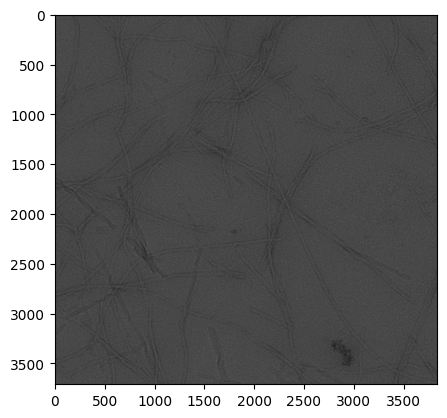

In [6]:
#Matplotlib Function
plt.imshow(micrograph.image)
plt.show()

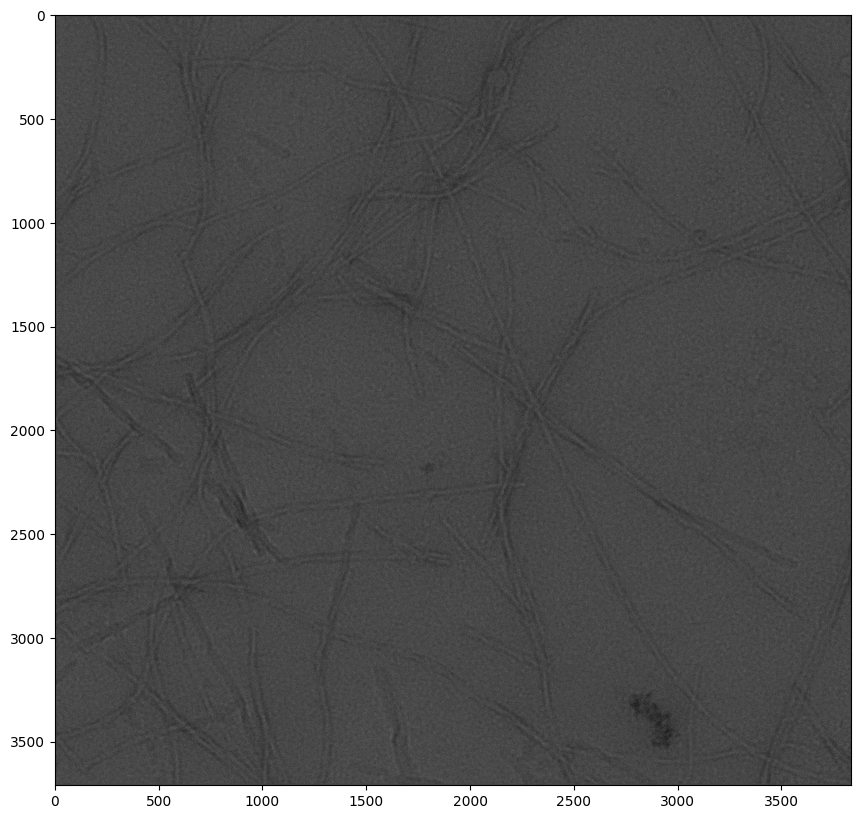

In [7]:
#SimpliPyTEM Function
micrograph.imshow()

You'll see that the results are different, this is because I have specified the size plotted in the object. There are lots of options to plot images with matplotlib and I recommend looking into them if you require clearer observation in an iPython environment. I generally use simple functions to plot here, and save the output for display purposes though.

This image has poor contrast, we will get onto how to improve this by altering the image later, but for now we can adjust how it is plotted to improve the contrast. Here we use the `vmax` and `vmin` parameters with the `micrograph.imshow()` function 

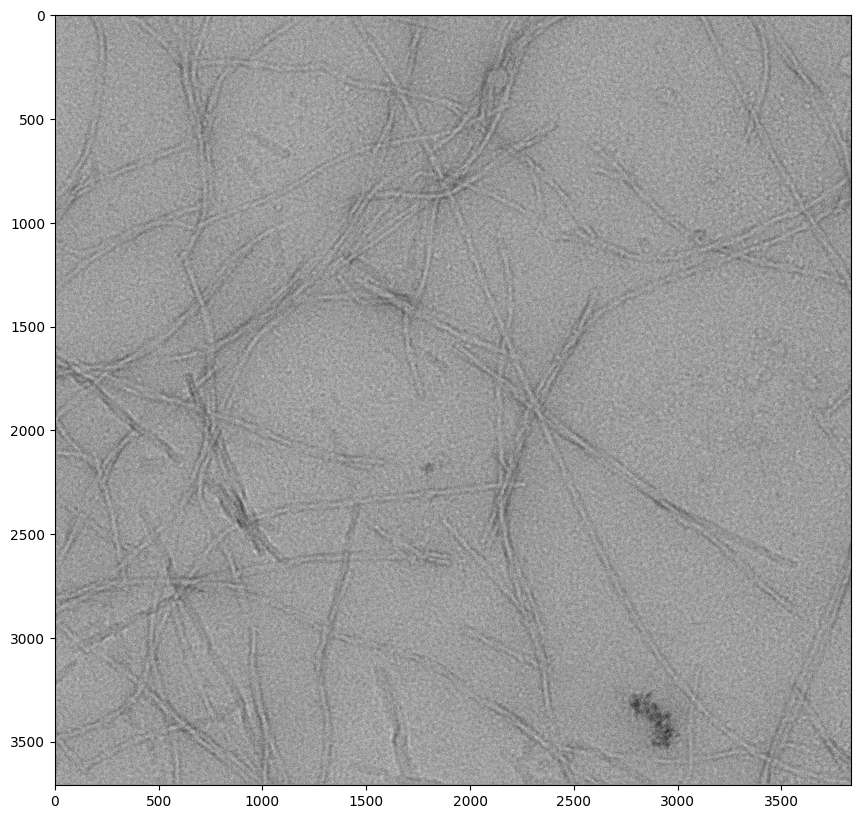

In [8]:
micrograph.imshow(vmax=60, vmin=20)

To choose the vmax and vmin values, we can use the plot_histogram() function to show the histogram of the image:

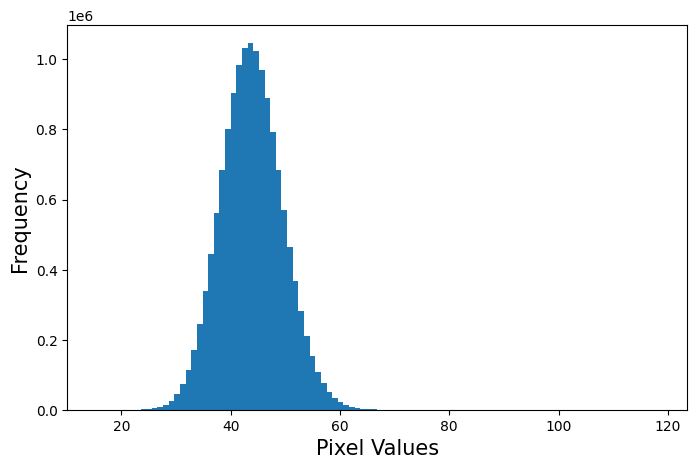

In [9]:
micrograph.plot_histogram()

This has an additional parameter to allow viewing it beside with the `sidebyside` parameter, and the `vmax` and `vmin` adjusted as before:

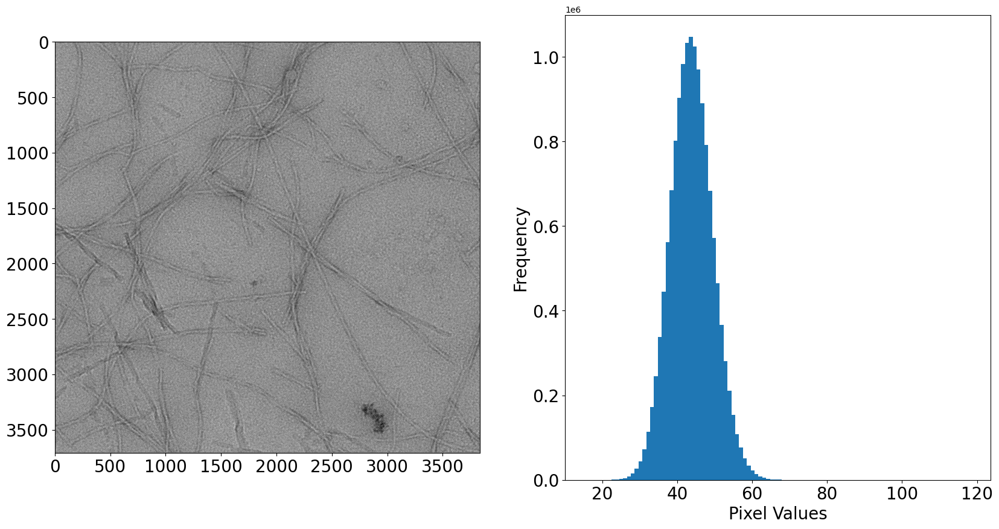

In [10]:
micrograph.plot_histogram(sidebyside=True, vmin=25, vmax=60)

## Other properties and metadata

Now we have the most important thing sorted, the image. However, theres lots of other useful information stored in a Micrograph object, this is particularly true when opening a digital micrograph file. We can access this as follows: 

### What is the pixel size of my image? 

In [11]:
print(micrograph.pixel_size)

0.28827664256095886


well that could mean anything, what is the unit? 

In [12]:
print(micrograph.pixel_unit)

nm


Thats great but can I get that in µm? 

In [13]:
micrograph.change_scale_unit('µm')
print(micrograph.pixel_size, micrograph.pixel_unit)

0.0002882766425609589 µm


How about other units? 

In [14]:
# To get units other than nm and µm, you have to include a scaling factor to multiply the current value by. 
# For example, to go from µm to mm, you have to multiply by 1/1000 or 0.001, here you would do: 

micrograph.change_scale_unit('mm', 0.001)
print(micrograph.pixel_size, micrograph.pixel_unit)


2.882766425609589e-07 mm


Well thats confusing! Lets change it back to nanometers:

In [15]:
micrograph.change_scale_unit('nm')

Error! You want to switch to nm but the transition from mm is not naturally supported, please include a scaling factor (even if its just 1) to ensure correct conversion.


Ah! we need to include a scaling factor to go back from millimeters because only 'nm'/'µm' are supported by default. Lets add the scaling factor and get it back to normal: 

In [16]:
micrograph.change_scale_unit('nm', 1000000)
print(micrograph.pixel_size, micrograph.pixel_unit)

0.28827664256095886 nm


How about if my image didnt have the pixel_size in the metadata?

For single files manual editing is as easy, but the advantage of using the function is you can use when looping over the files in a single command. If you are changing to the current unit it will skip the file, so you can use it to ensure all the files you are working with are the same unit.

In [17]:
# Easy! Take a measurement of the scale-bar or work out the pixel size from other means
# Then use set the scale with set_scale()

micrograph.set_scale(pixels=1, dist=0.288, unit='nm')
print(micrograph.pixel_size, micrograph.pixel_unit)

0.288 nm


In [18]:
#Maybe we have an image with a scalebar - measure the size of the scale-bar and use this value and the distance here
# In this example, I measured a 50nm scalebar to be 173.6 pixels

micrograph.set_scale(173.5, 50, 'nm')
print(micrograph.pixel_size, micrograph.pixel_unit)


0.2881844380403458 nm


Anyway, lets move on from the scale. If the pixel size is 0.288, what magnification does that mean it was? 

In [19]:
print(micrograph.get_mag())

(12000.0, 17344.450588235293)


This returns two values. The first is the indictated magnification, this is what is shown on screen when you are using the microscope, but is not always accurate to what is captured at the detector. The second value is the actual magnification. 

In [20]:

indicated_mag, actual_mag = micrograph.get_mag()
print('Indicated mag:',indicated_mag)
print('Actual mag:', actual_mag)

Indicated mag: 12000.0
Actual mag: 17344.450588235293


How about other imaging conditions? Voltage? Exposure? Acquisition date and time? 

In [21]:
voltage = micrograph.get_voltage()
print(voltage)

exposure = micrograph.get_exposure()
print('Exposure time: ',exposure,'seconds')

print(micrograph.get_date_time())

200000.0
Exposure time:  5.0 seconds
('05/11/2021', '21:26:38')


Hold on a second! Why do some of these require brackets (eg. .get_voltage(), but some don't e.g. .pixel_size? 

*It seemed to me writing this some properties are required often so should be saved as default, others my only be required at specific occasions and can be kept hidden. The good thing is, once you have run these 'getter' functions, the data is printed, returned and saved to the object. This final point means once you have run the getters once, you can just try this:*

In [22]:
print(micrograph.voltage)
print(micrograph.exposure)
print(micrograph.AqDate, micrograph.AqTime)
print(micrograph.indicated_mag, micrograph.actual_mag)

200000.0
5.0
05/11/2021 21:26:38
12000.0 17344.450588235293


Ok this is good, but I need to check a very specific setting, is this saved anywhere? 

*Well I'm not making any promises but if the setting is saved in the image metadata it should be available if you are willing to look for it. Try here:*


In [23]:
#micrograph.show_metadata()

#I've commented this out because it would take up several pages, but feel free to try it! 
#It prints out a series of tags + corresponding values eg:

# .ImageList.2.ImageTags.Microscope Info.Illumination Mode : TEM
#                                   Tag                     Value

Well it's there, but I want to find this on a whole bunch of files, is there a way to avoid looking through the list each time? 

*Yes, the metadata is saved as a dictionary in Micrograph.metadata_tags, find the name of the parameter from above and access it as follows:*

In [24]:
micrograph.metadata_tags['.ImageList.2.ImageTags.Acquisition.Device.Name']

'K2-0001'

*You can even save it to the object as follows:*

In [25]:
micrograph.Detector_model = micrograph.metadata_tags['.ImageList.2.ImageTags.Acquisition.Device.Source Model']
print(micrograph.Detector_model)

K2 summit


*if theres a setting you want regularly, you might consider making a getter function within the Micrograph_class.py file, search for the get_voltage() function for an example of how to do this*

You may want to save these values for multiple different images, perhaps add all the main metadata values a spreadsheet. This is easily doable here using `Micrograph.export_metadata()`, this saves the data into a comma separated value (csv) format which is compatible with excel and all other spreadsheet programs.

In [26]:
micrograph.export_metadata()

The data should now be saved to a file called 'metadata.csv', lets see if we can find it! 

In [27]:
#This line will list all the files in the current directory ('.') and print the ones with 'csv' in their name.
print([x for x in os.listdir('.') if 'csv' in x])

['Particle_data.csv', 'metadata.csv']


In [28]:
import pandas as pd
df = pd.read_csv('metadata.csv')
df.head()

,Image name,Indicated Magnification,Actual Magnifiation,Date,Time,Pixel size,Pixel unit,Exposure Time (s),Voltage,Size (px),Video,Frame Rate (fps),Number of frames
0,Fibrils_Example.dm3,12000.0,17344.450588,2021-05-11,21:26:38,0.288277,nm,5.0,200000.0,3838x3710,False,False,1
1,Fibrils_Example.dm3,12000.0,17344.450588,2021-05-11,21:26:38,0.288184,nm,5.0,200000.0,3838x3710,False,False,1
2,Fibrils_Example.dm3,12000.0,17344.450588,2021-05-11,21:26:38,0.288184,nm,5.0,200000.0,3838x3710,False,False,1
3,Fibrils_Example.dm3,12000.0,17344.450588,2021-05-11,21:26:38,0.288184,nm,5.0,200000.0,3838x3710,False,False,1
4,Fibrils_Example.dm3,12000.0,17344.450588,2021-05-11,21:26:38,0.288184,nm,5.0,200000.0,3838x3710,False,False,1


Now the key thing here is if I ran `export_metadata()` with many files, these would be appended to the table.

You can also give the file a specific name and even give an output folder, just add these as parameters:

In [29]:
micrograph.export_metadata('Example_metadata.csv', outdir='Example')


In [30]:
os.listdir('Example')

['Example_metadata.csv']

## Micrograph Editing

These are some basic functions to edit the micrograph. 


### Convert to 8 bit 
 
Micrographs generally come as 32-bit or 16-bit images, this means the pixel values can between 0 and (2^16-1) or (2^32-1), with 32-bit having the added complication of having floating point numbers (decimals) rather than just integers. This allows much more data to be kept in an individual image, and much more contrast available in the individual image. However, most uses for images (including simple viewing with the majority of programs) require 8-bit images. Therefore, we often need to convert to 8-bit, so there is a simple method to do so provided in the Micrograph object:

In [31]:
micrograph8bit = micrograph.convert_to_8bit()

We can check if it works by checking the pixel values of the image:

In [32]:
print('Original max = {} :  8bit max =  {}'.format(micrograph.image.max(), micrograph8bit.image.max()))
print('Original min = {} :  8bit min =  {}'.format(micrograph.image.min(), micrograph8bit.image.min()))
print('Original mean= {} :  8bit mean=  {}'.format(micrograph.image.mean(), micrograph8bit.image.mean()))

Original max = 118.39791870117188 :  8bit max =  255
Original min = 15.252153396606445 :  8bit min =  0
Original mean= 43.88248825073242 :  8bit mean=  70.28078226108893


We can see this therefore scales the image between 0 and 255 (2^8 - 1) and makes the values integers, thus making it an 8-bit image
Lets just check to see what effect it has on the image: 

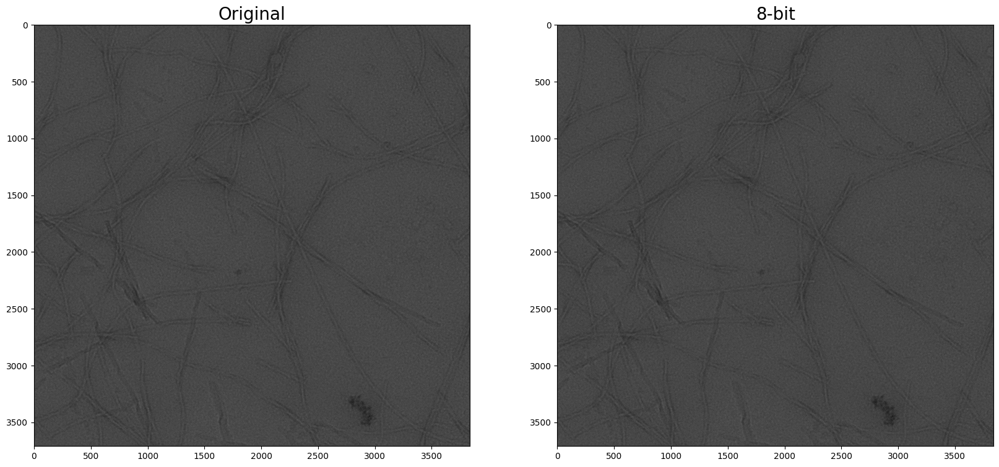

In [33]:
micrograph.show_pair(micrograph8bit.image, title1='Original', title2='8-bit')

No obvious effect?! This is for 2 reasons: 
- Firstly, we cant see all the contrast contained in the image, for viewing purposes 8bit is as good as we need, the additional contrast from higher bit images only helps when contrast is edited/enhanced.
- Secondly, I have plotted this with plt.imshow from matplotlib. This automatically scales the image to show the minimum value in the image as black and the max as white.

Lets try plotting it with a defined max and min value (which is what we would see when saving the image):


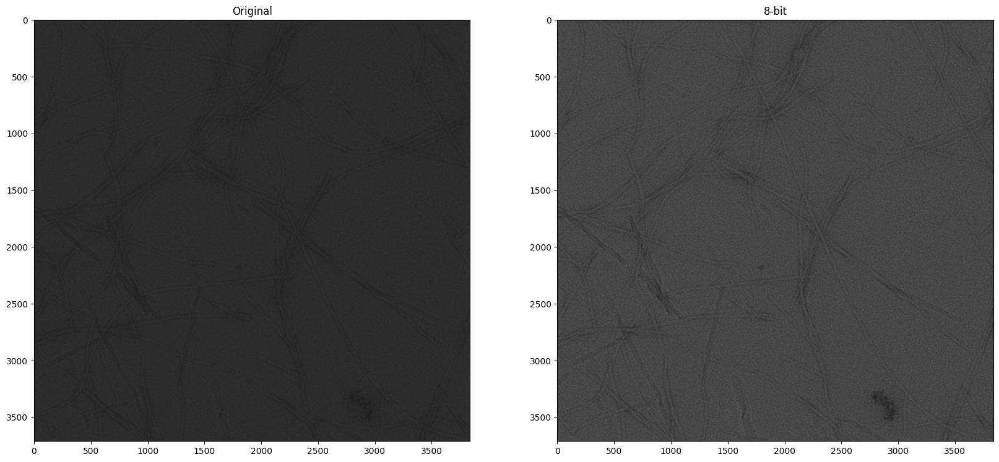

In [34]:
fig, ax = plt.subplots(1,2, figsize=(20,10))
ax[0].imshow(micrograph.image, vmax=255, vmin=0)
ax[0].set_title('Original')
ax[1].imshow(micrograph8bit.image, vmax=255, vmin=0)
ax[1].set_title('8-bit')
plt.show()

Now we can see the difference. 

Converting to 8-bit will therefore enhance the contrast by scaling it between the max and min values of an 8-bit image. It is also required to perform many functions, many of these will convert automatically when using the micrograph object, but its good to keep this in mind.  

## Improving  contrast



Contrast can be enhanced using Three different functions: micrograph.clip_contrast(), micrograph.enhance_contrast() and micrograph.eqHist(), the latter two both make use of [functions from openCV](https://docs.opencv.org/3.4/d3/dc1/tutorial_basic_linear_transform.html).

My favourite however, is clip contrast because this will give the most consistent results. 

### Clip Contrast

A digital image is an array of pixels with values between a maximum and minimum value, which in the case of 8 bit images are 0 and 255. The number of pixels with each value can be seen in a histogram, a built in function for this is included in the micrograph object:


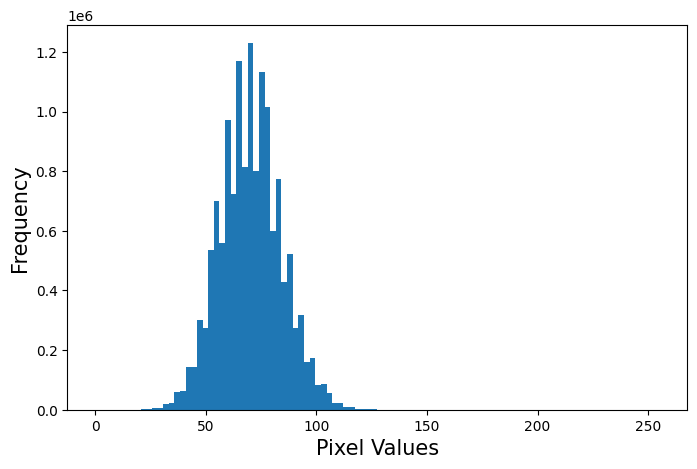

In [35]:
micrograph8bit.plot_histogram()

We can see in this histogram that the image does not include the full range of pixel intensities, and instead is mainly in the range of 50-150. This means the image will look 'flat' or 'grey' containing few examples of true black or true white in the image. we can see this if we plot it with defined values:

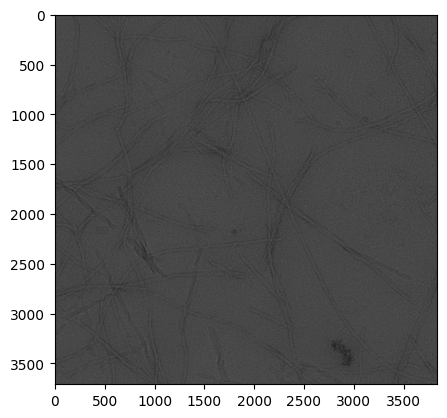

In [36]:
plt.imshow(micrograph8bit.image, vmax=255, vmin=0)
plt.show()

See? We have no black or white pixels, instead we just see shades of grey. 

To improve this, we can just pull the histogram so that the pixel range represented by the peak in the histogram, 50-150 are spread over the range 0 to 255. This is where the clip_contrast function comes in:

In [37]:
micrograph8bit_enhanced = micrograph8bit.clip_contrast(maxvalue=150, minvalue=50)

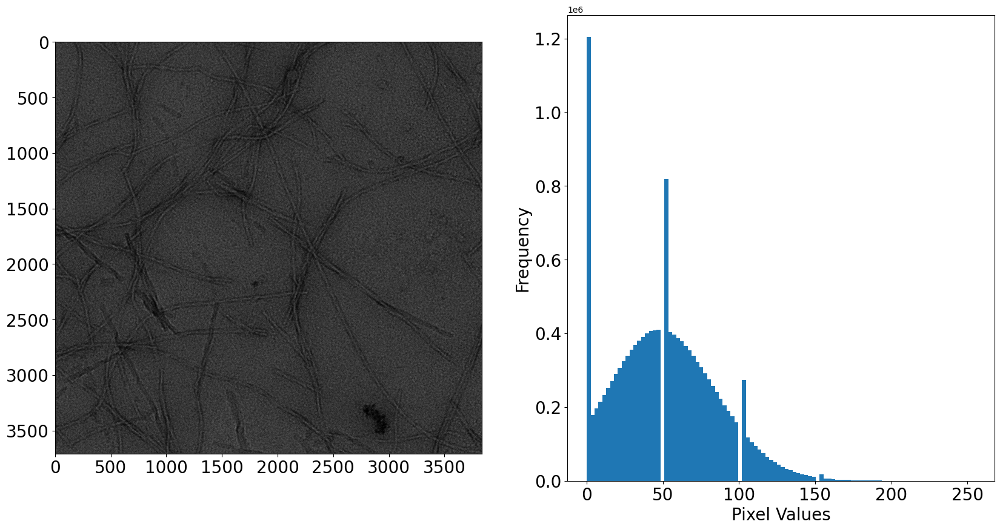

In [38]:
micrograph8bit_enhanced.plot_histogram(sidebyside=True)

Looks a bit better right!

But what if we don't want to have to manually choose the range to clip the contrast? Well theres a value which can be used instead of the max and min value - the saturation. 

The saturation is the percentage of pixels in the original video that will be set to 0 or 255 (and are therefore 'saturated'). Therefore this is a value which increases with the contrast. This is by default set to 0.5 which is quite a strong contrast, however the value can be set manually.

Saturation =  0.5
Maxmium value :  108.0
Minimum value :  36.0


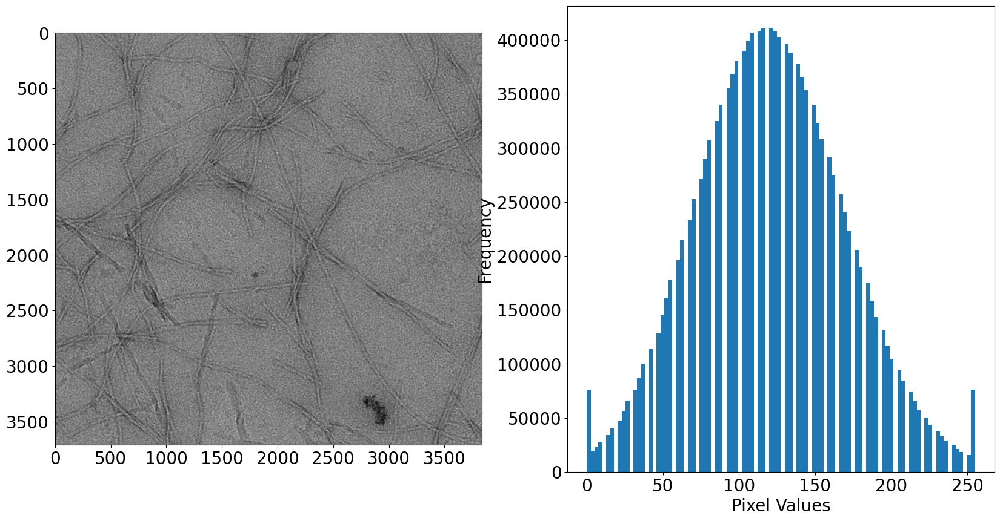

In [39]:
micrograph8bit_clipped05 = micrograph8bit.clip_contrast()

micrograph8bit_clipped05.plot_histogram(sidebyside=True)

That gives a stronger effect! 

Lets look at how the saturation changes the contrast:

Saturation =  0.1
Maxmium value :  116.0
Minimum value :  30.0
Saturation =  0.5
Maxmium value :  108.0
Minimum value :  36.0
Saturation =  1
Maxmium value :  104.0
Minimum value :  39.0
Saturation =  5
Maxmium value :  94.0
Minimum value :  48.0
Saturation =  10
Maxmium value :  88.0
Minimum value :  53.0
Saturation =  25
Maxmium value :  79.0
Minimum value :  61.0


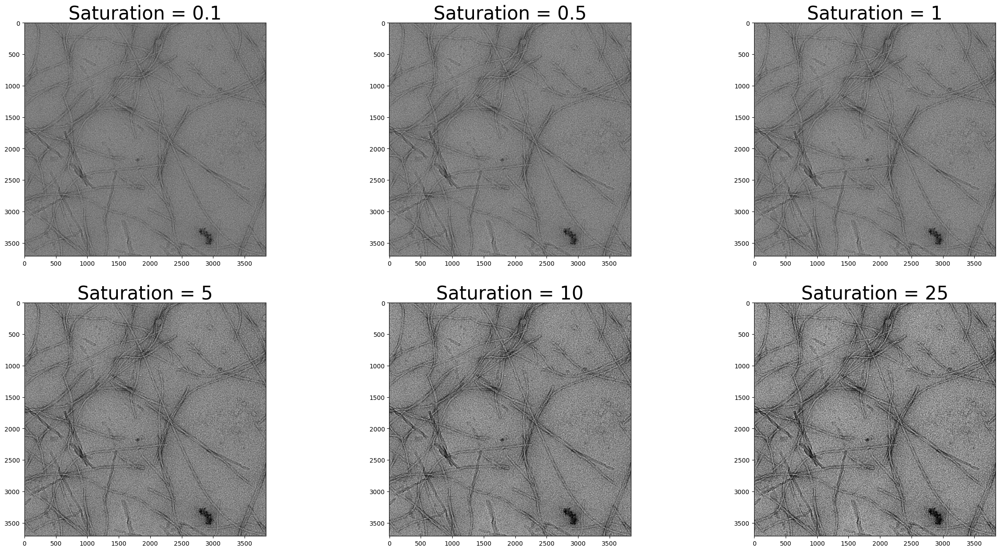

In [40]:
saturations = [0.1, 0.5,1, 5,10,25]

fig, ax = plt.subplots(2,3, figsize=(30,15
                                    
                                    ))
for i in range(len(saturations)):
    sat = saturations[i]
    clipped = micrograph8bit.clip_contrast(saturation = sat)
    j=0
    if i>2:
        j=1
        i=i-3
    ax[j, i].imshow(clipped.image)
    ax[j, i].set_title('Saturation = {}'.format(sat), fontsize=30)

plt.show()


### Enhance_contrast 

Takes either 2 or 3 inputted values, these are alpha, beta and gamma (optional). 
- Alpha controls contrast, and is normally used in ranges of 1-3. 
- Beta is a brightness control and simply adds this value to every pixel in the image. This will only have a major affect with 8-bit images and is best used with values between -100 and +100 (negative is making the image darker. 
- Gamma controls contrast in a non-linear way. Values between 0-1 makes the image brighter (particularly dark pixels) whilst values >1 darken the image. Gamma requires an 8bit image and if included will automatically convert the image to 8bit.


For more information on these I recommend the link above.

The default is to run with alpha=1.5, beta=0 and no gamma. This is difficult to automate, and so its best to choose settings manually. 


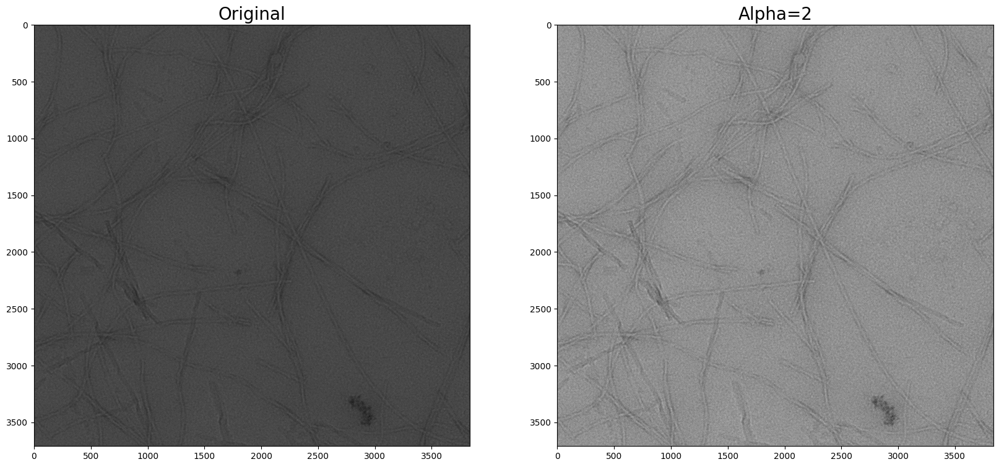

In [41]:
micrograph_alpha2 = micrograph8bit.enhance_contrast(alpha=2)
micrograph8bit.show_pair(micrograph_alpha2.image, title1='Original', title2='Alpha=2')


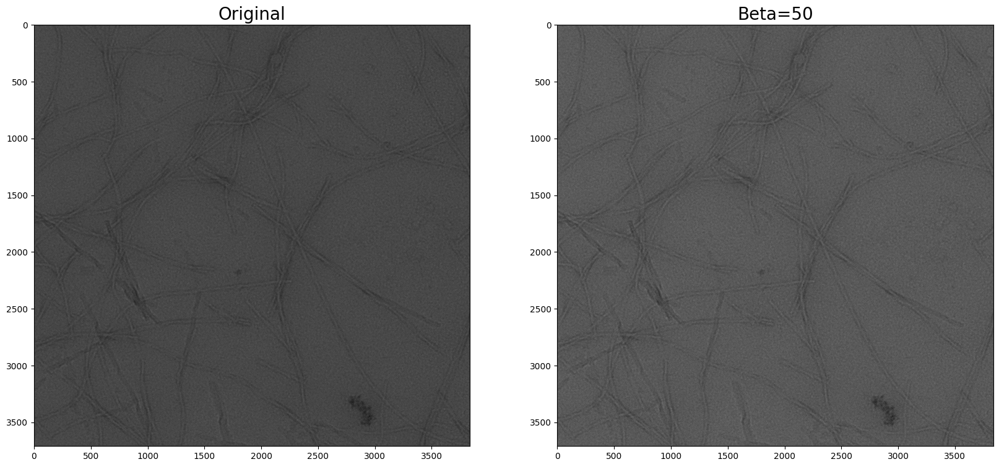

In [42]:
micrograph_beta50 = micrograph8bit.enhance_contrast(alpha=1, beta=50)
micrograph8bit.show_pair(micrograph_beta50.image, title1='Original', title2='Beta=50')

Gamma adjusted...


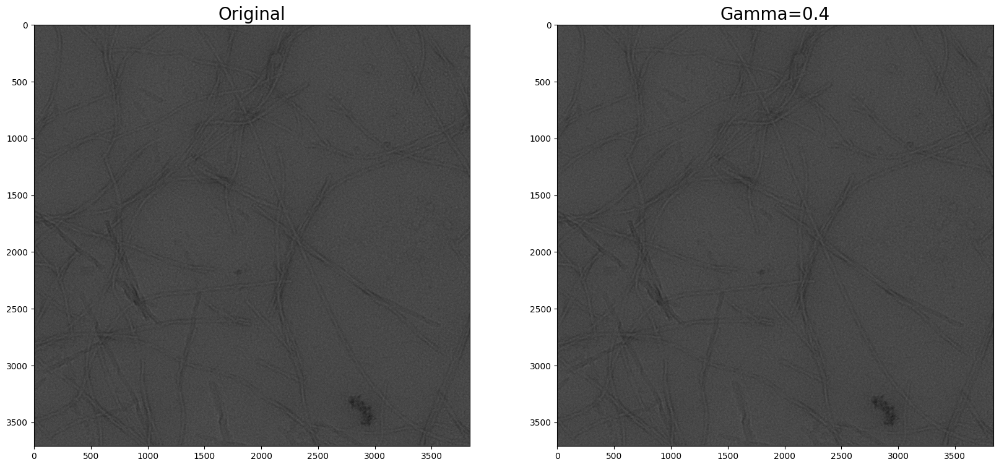

In [43]:
micrograph_gamma05 = micrograph8bit.enhance_contrast(alpha=1, beta=0, gamma=0.4)
micrograph8bit.show_pair(micrograph_gamma05.image, title1='Original', title2='Gamma=0.4')

### Histogram equalisation 

Histogram equalisation is a method to ensure the pixel values spread the possible values much evenly, flattening the histogram of pixel values. This process can be very effective at enhancing features, particularly with in images with a very dark patch or a very bright patch, the contrast in the midtones can be massively enhanced. 

This again only works on 8bit images, and thus the method in the micrograph object automatically converts it to 8bit using the function detailed above. 

This implementation also uses openCV and more information on the process can be [found here](https://docs.opencv.org/3.4/d4/d1b/tutorial_histogram_equalization.html). 

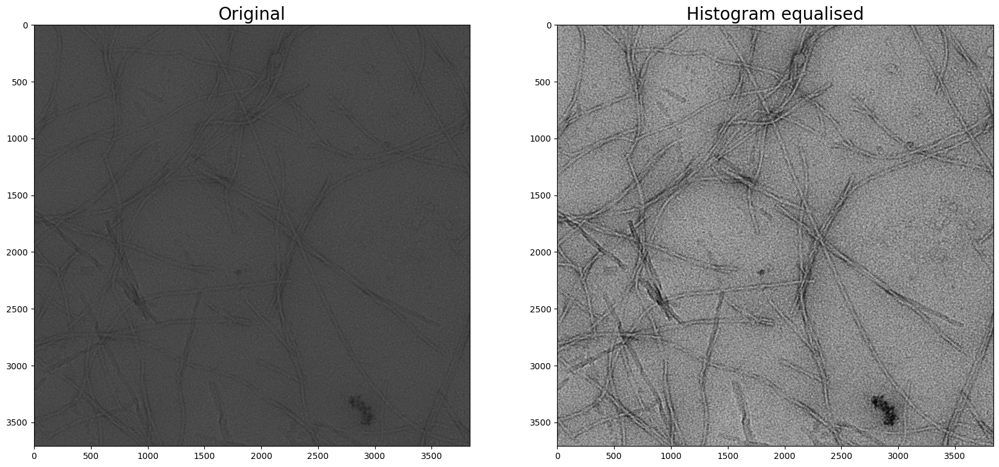

In [44]:
micrographHistEQ = micrograph.eqHist()
micrograph.show_pair(micrographHistEQ.image, title1='Original', title2='Histogram equalised')

## Cropping 

As mentioned earlier, the image is stored within a numpy array which is accessible with `micrograph.image` . A numpy array is simply a matrix of rows and columns of data, in this case, pixel values. 

We can see the number of rows and columns using the shape attribute: 

In [45]:
print(micrograph.image.shape)
# Or simply...
print(micrograph.shape)

(3710, 3838)
(3710, 3838)


Now one point to note here - the shape, and the numpy array in general is listed as (y, x) rather than (x,y). If you look at the images above you will notice that its actually the y axis that is slightly longer. 

And we can access values by just printing the image: 

In [46]:
print(micrograph.image)

[[52.089466 39.773148 43.41286  ... 35.300556 42.331833 43.40659 ]
 [39.262318 49.577892 49.274826 ... 38.2093   38.818825 43.62618 ]
 [43.580738 40.22479  46.115982 ... 41.816288 44.1948   41.947773]
 ...
 [42.248367 43.072895 42.31351  ... 45.540817 48.220936 43.634693]
 [42.179142 43.35456  40.60197  ... 46.814804 42.375847 43.067215]
 [44.72727  44.607174 42.7264   ... 44.787712 49.62584  42.920315]]


To get value from the image at a particular coordinate, we use indexing in the form `[y,x]`, for example to get the value at (150, 2000) (as x,y), we can use:

In [47]:
micrograph.image[2000,150]

41.792625

Now to select an area rather than just a single pixel, we use slicing. Slicing uses `:` in 4 ways (here using i and j as two integers to demonstrate): 

    - `:` on its own means EVERYTHING
    - `:i` means everything upto (but not including) the value at index i
    - `j:` means everything from j (and including j) to the end
    - `j:i` means everything between j and i, j is included but i is not. 
    
Now we do this for each axis but lets start with just working with the y axis. here I am going to use matplotlib directly to only plot the cropped region, rather than using the built in imshow function but we will see how to then crop the region into the same object or a new object shortly. 

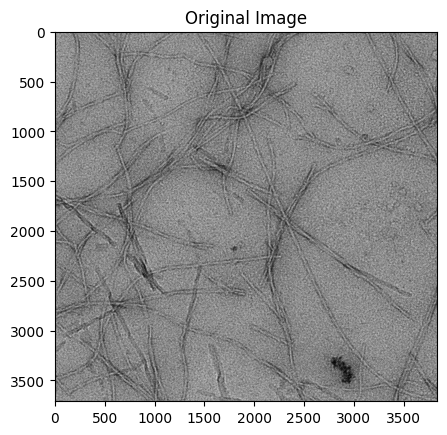

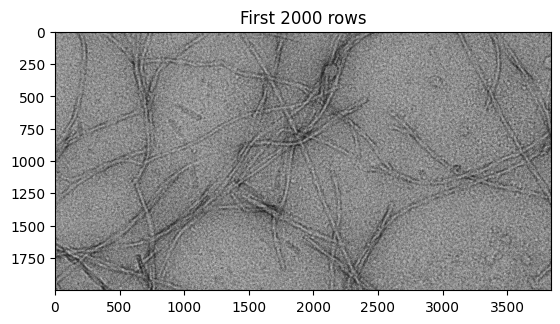

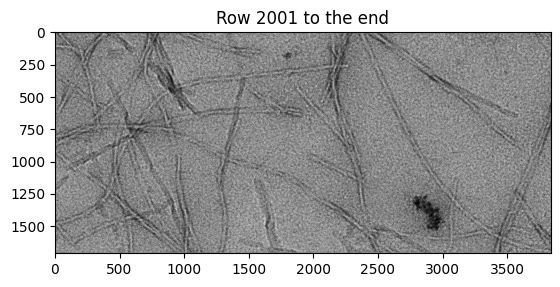

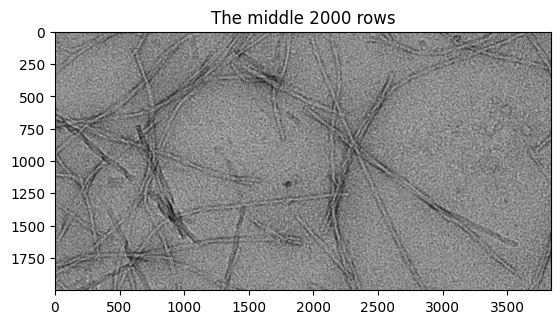

In [48]:
plt.imshow(micrographHistEQ.image)
plt.title('Original Image')
plt.show()

# Show only the first 2000 rows on the y axis 
plt.imshow(micrographHistEQ.image[:2000, : ])
plt.title('First 2000 rows')

plt.show()
# Show from row 2000 to the end:

plt.imshow(micrographHistEQ.image[2000:, : ])
plt.title('Row 2001 to the end')
plt.show()


plt.imshow(micrographHistEQ.image[1000:3000,:])
plt.title('The middle 2000 rows')
plt.show()

Now lets do the same with the x axis: 

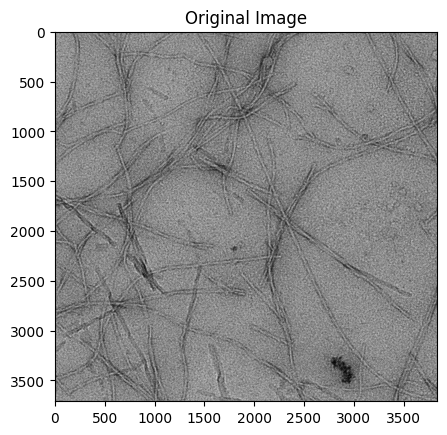

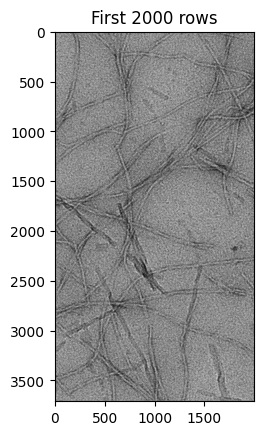

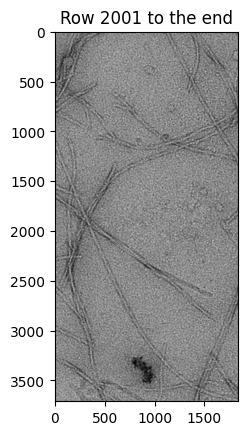

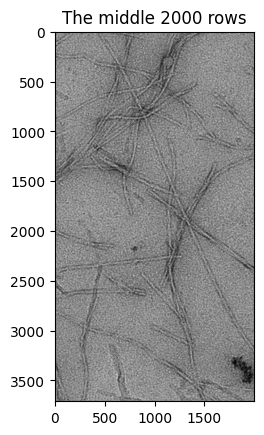

In [49]:
plt.imshow(micrographHistEQ.image)
plt.title('Original Image')
plt.show()

# Show only the first 2000 rows on the y axis 
plt.imshow(micrographHistEQ.image[:, :2000 ])
plt.title('First 2000 rows')

plt.show()
# Show from row 2000 to the end:

plt.imshow(micrographHistEQ.image[:,2000: ])
plt.title('Row 2001 to the end')
plt.show()


plt.imshow(micrographHistEQ.image[:,1000:3000])
plt.title('The middle 2000 rows')
plt.show()

Finally, lets combine the two start making some square crops: 

In [50]:
print([x/2 for x in micrograph.shape ])

[1855.0, 1919.0]


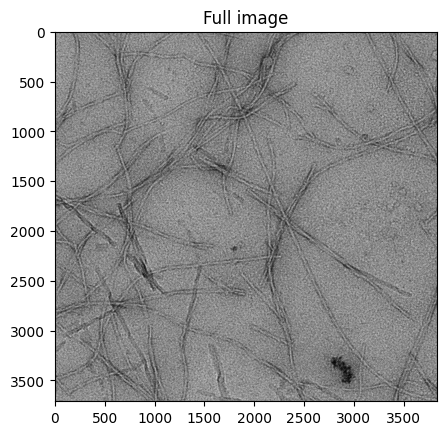

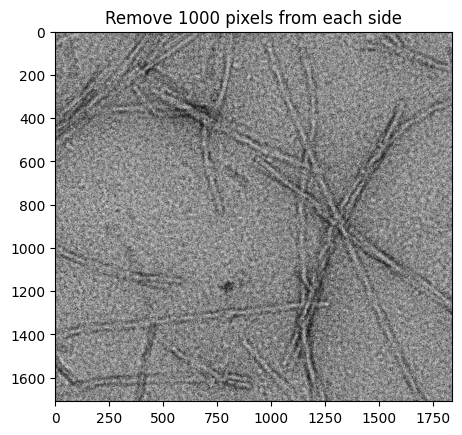

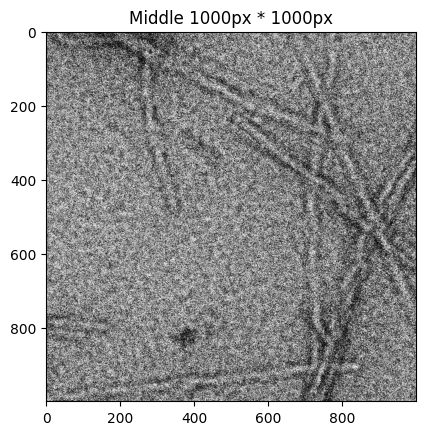

In [51]:


plt.imshow(micrographHistEQ.image)
plt.title('Full image')
plt.show()
# Here I'm removing 1000 rows/columns from each edge, I use negative slice values to count backwards, ie -1 is the final value, -2 is penultimate etc
plt.imshow(micrographHistEQ.image[1000:-1000, 1000:-1000])
plt.title('Remove 1000 pixels from each side')
plt.show()

# Here I am taking the 1000 rows/columns each side of th center point (1855,1919)
plt.imshow(micrographHistEQ.image[1355:2355, 1419:2419])
plt.title('Middle 1000px * 1000px')
plt.show()

So now we know how to see these parts of the image, the next thing to do is edit it in the current object or make it into a new object, to do this, we simply set the .image attribute to what we want. 

To create a new object we can use the function `deepcopy()` from the copy library, this should be imported with the micrograph but we will reimport here it in case something goes wrong. 

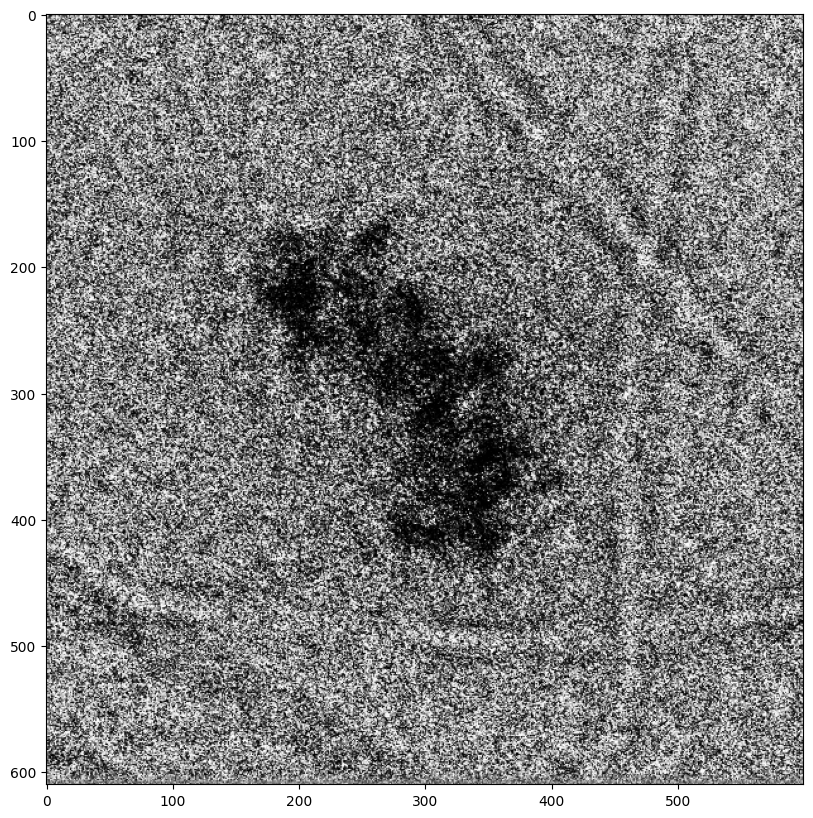

In [52]:
from copy import deepcopy

#create copy of your micrograph:
cropped_im = deepcopy(micrographHistEQ)

#Assign the cropped image to your new object's image attribute. 
#Theres a black particle mass at the bottom right which I am going to try to focus on here
cropped_im.image = micrographHistEQ.image[3100:, 2600:3200]

#Now lets look at the new image in the normal way
cropped_im.imshow()


Now there is one problem we have here. There are a number of attributes of the micrograph object which are based on the size of the micrograph, including the .shape attribute (note that .image.shape will still work). This may cause issues later on, most significantly, the `make_scalebar()` may no longer work properly. 

There is an easy fix for this though, simply run `reset_xy()`. 

In [53]:
print('Shape mismatch post-cropping: \n')
print('Micrograph.shape: ', cropped_im.shape)
print('Micrograph.image.shape:', cropped_im.image.shape, '\n\n')

#This mismatch may cause issues, particularly making a scalebar 

#Fix it with one command: 

cropped_im.reset_xy()
print('After reset_xy(): \n')
print('Micrograph.shape: ', cropped_im.shape)
print('Micrograph.image.shape:', cropped_im.image.shape )

Shape mismatch post-cropping: 

Micrograph.shape:  (3710, 3838)
Micrograph.image.shape: (610, 600) 


After reset_xy(): 

Micrograph.shape:  (610, 600)
Micrograph.image.shape: (610, 600)


## Micrograph Filters

Now we are getting to the fun bit. Micrographs can look a bit rubbish as raw files, lets see if we can use the micrograph object to improve it a bit! 

These filters have been implemented to make them as simple as possible to use. I encourage users to familiarise yourselves with the filter and the code behind it (see Image filters section of Micrograph_class.py), as there may be settings which I have not made available for simplicity's sake but could be useful for you. However, for normal analysis, these should be perfectly effective. 

In SimpliPyTEM, filters return a new micrograph object with a filtered image, this allows trying different filters/parameters without risking overwriting the image.

First, lets see how it looks already:

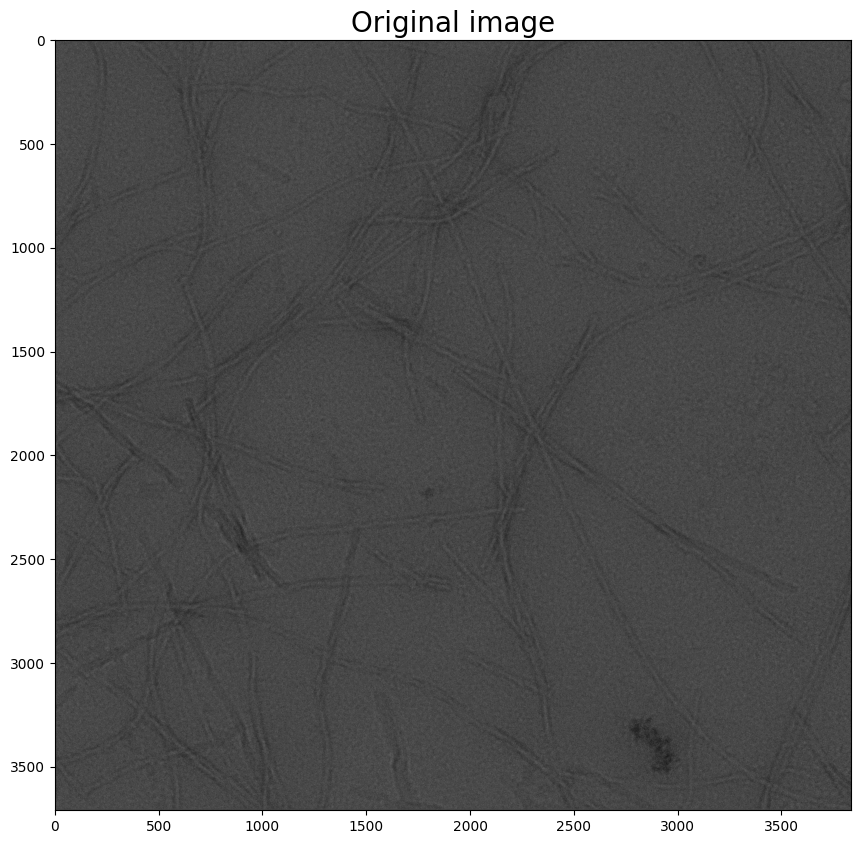

In [54]:
micrograph.imshow(title='Original image')

Looks quite noisy, lets try to filter it a bit...

### Gaussian filter

This is one of the most common image filters and is used to smooth an image. Here I use OpenCV's image function within the Micrograph_class, keeping only one setting: the kernal, this needs to be an odd integer. A bigger kernal leads to a stronger blurring effect.

In [55]:
#this is the syntax for image filters:
MicrographGaussian = micrograph.gaussian_filter(7)


So here I've done a gaussian filter of the micrograph, which returns a new micrograph object that has been gaussian filtered. The kernal is defined by the '7' - this means a 7px by 7px kernal. 7Px is a large filter 

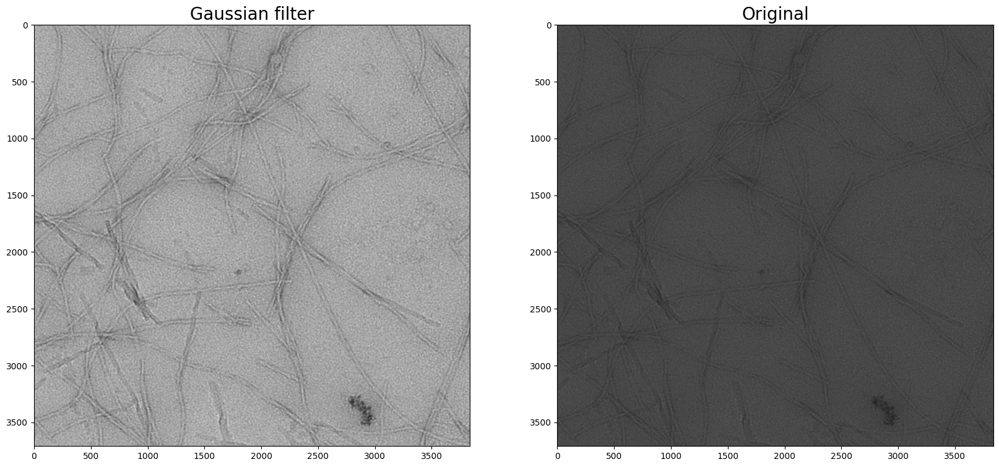

In [56]:
MicrographGaussian.show_pair(micrograph.image, title1='Gaussian filter', title2='Original') #
# this is a built in function to view a pair of images side by side using plt.subplots 
# you this can be improved by making your own function, but this works for a quick check
# here the first 



### Median Filter

This is another common filter, and can effectively reduce 'salt-and-pepper' noise (anomalously low or high pixel values), this replaces each pixel with the median of the pixels around it in an n\*n square, where n is the kernal size. Again, the kernal size has to be odd, and a larger number gives a stonger effect. 

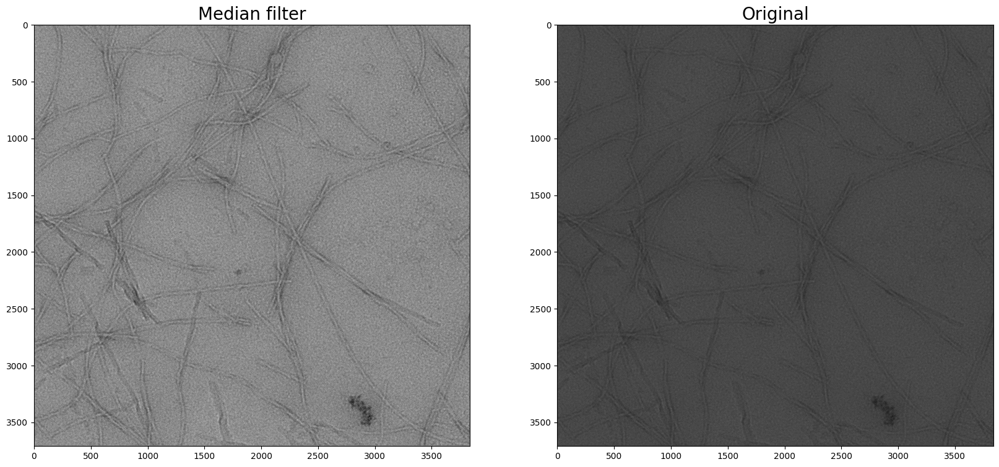

In [57]:

MicrographMedian = micrograph.median_filter(3)
MicrographMedian.show_pair(micrograph.image, title1='Median filter',title2='Original' )

### Weiner filter

This is a more complex filter, which can filter out noise from corrupted signal. It can be effective for TEM images. This is implemented using the scipy.signal library.

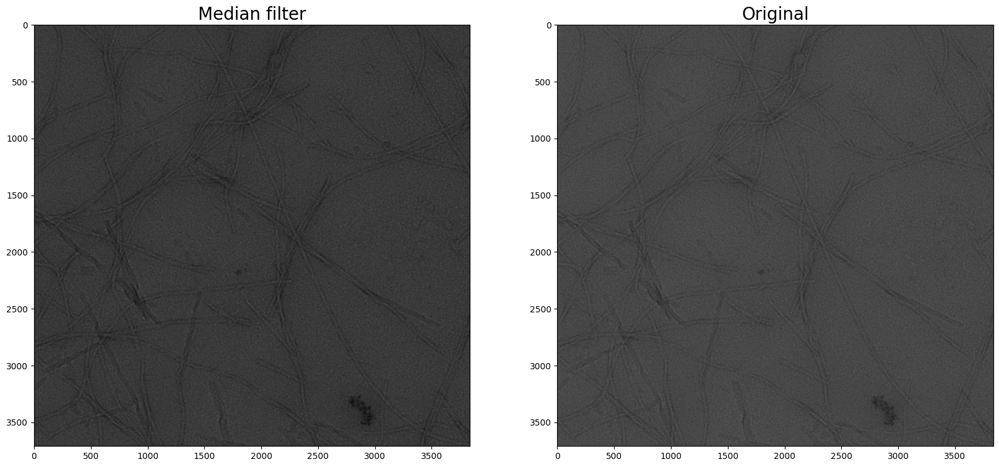

In [58]:
micrographWeiner = micrograph.weiner_filter(5)
micrographWeiner.show_pair(micrograph.image, title1='Median filter', title2 = 'Original')

### Low pass filtering

This filters the image based on the fourier transform of the image, allowing one to filter it to a required resolution. While this generally produces patterned artefacts, it can greatly enhance the contrast while sacrificing the higher resolution features. I have found this to be very effective at enhancing large, low contrast features. 

Assuming your micrograph object has a pixel size defined, the filter works by removing any features smaller than the size you input as a parameter (the unit is the same as the pixel_size). Therefore, a larger number yields a stronger filter. Beware because if it is too large, you won't see any features. Effective filter sizes depends on features and magnification, but maybe start with something like 5 and tune it to your needs.

If your micrograph is missing a pixel_size (maybe because you are not using a micrograph file, but a regular tif), then the size input will be the radius of a circle kept in the power spectrum. The result of this is the input number does the inverse - a smaller number leads to stronger filter. In this case, much larger numbers will be needed, so maybe start with 50 and from there. 

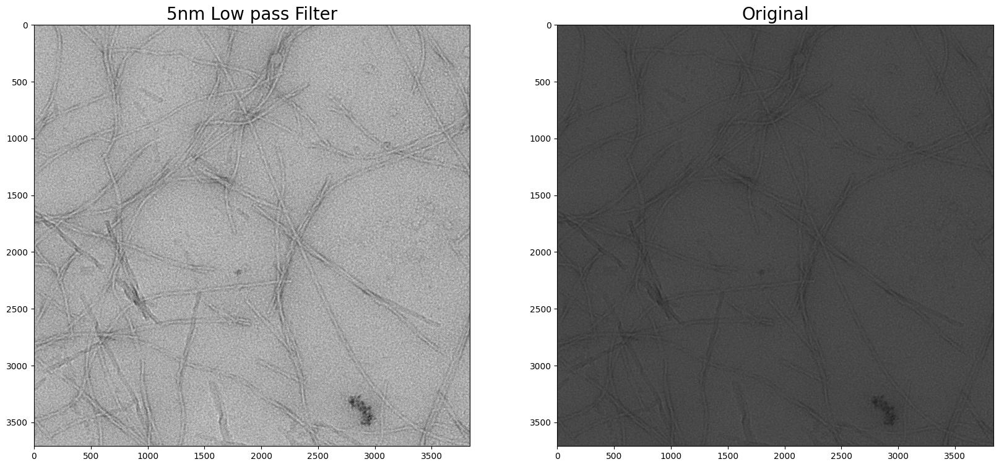

In [59]:
micrographLowPass_5nm = micrograph.low_pass_filter(5) #filtering to 5nm
micrographLowPass_5nm.show_pair(micrograph.image, title1='5nm Low pass Filter', title2='Original')

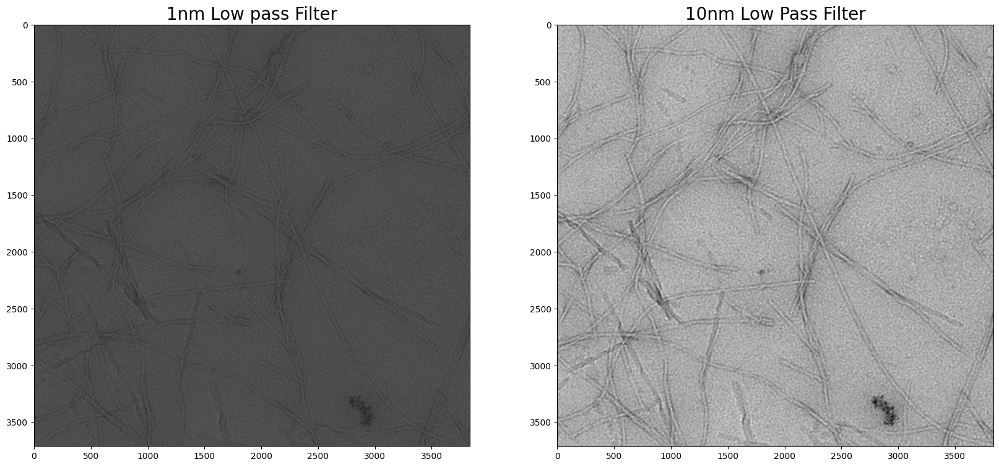

In [60]:
micrographLowPass_1nm = micrograph.low_pass_filter(1) #filtering to 1nm
micrographLowPass_10nm = micrograph.low_pass_filter(10)
micrographLowPass_1nm.show_pair(micrographLowPass_10nm.image, title1='1nm Low pass Filter', title2='10nm Low Pass Filter')

Here the 5nm LP filter greatly enhances the fibre in the image, while the 1nm shows a much more subtle, but still noticable improvement. 10nm is too strong however, and only artefacts remain.  

### Non-local means filter

This is a filter implemented using the openCV library, and [their description of the process](https://docs.opencv.org/3.4/d5/d69/tutorial_py_non_local_means.html) is pretty good. It denoises by comparing and averaging over different areas of the image. This can be effective, even if it does not appear so in this example. 

There are a few parameters allowed by openCV but I have only included one in this implementation - h, h controls the strength of the filter, with a bigger number leading to better noise removal but also more removal of the image. 

I don't find this filter amazing but I'm sure in certain circumstances it will be effective.

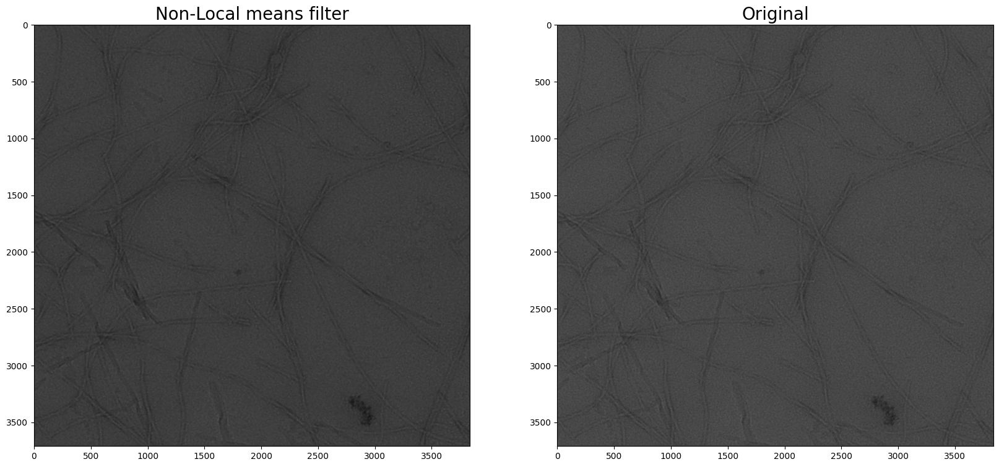

In [61]:
micrographNLM = micrograph.nlm_filter(20)
micrographNLM.show_pair(micrograph.image, title1='Non-Local means filter', title2='Original')

## Add a scalebar

Every microscopist knows an micrograph means nothing without a scalebar, so I've made the process very easy. With a single command, it will choose a scalebar length, position and color (either black or white depending on contrast in local area).

I recommend adding the scalebar as a final step to the analysis process, because the scale bar perminently changes the pixel values to the max or min value, which will mess with any contrast enhancement (particularly scaling the image to the max and min). Also the filters will blur the scalebar. 

Unlike all the other adjustments, this doesnt return a new image, but will simply modify the image present, this is because it should be the final step and there are no real parameters to adjust to get it right. If you want to keep the original I recommend using deepcopy() to copy the micrograph object, as I have below. 


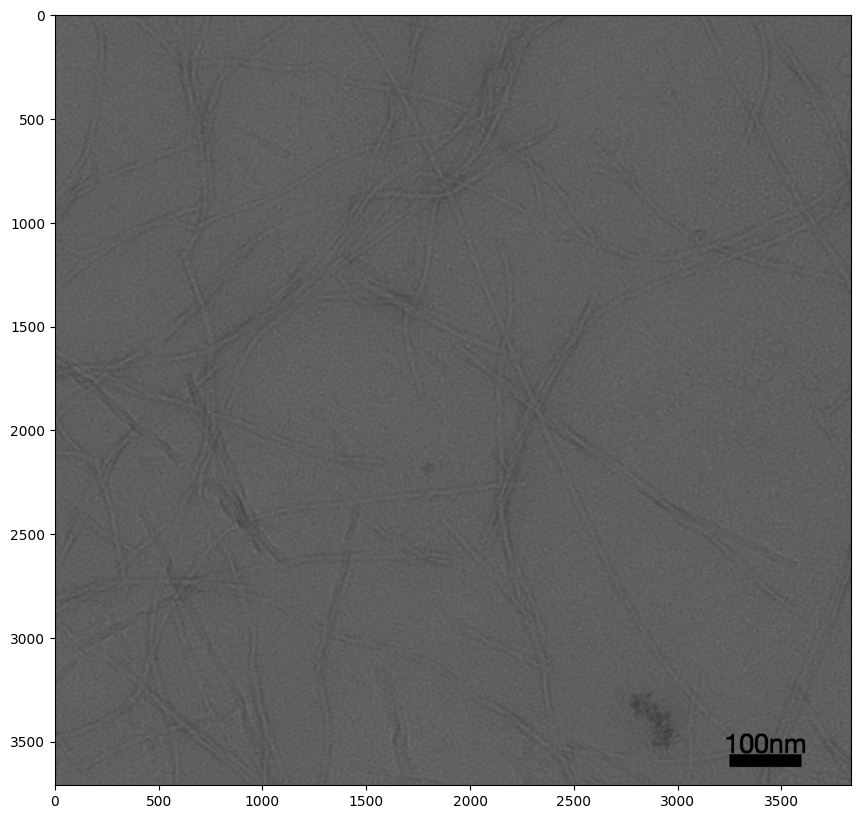

In [62]:
micrographSB = micrograph.make_scalebar()
micrographSB.imshow()

Oh no! The scalebar has messed up the contrast shown. This is because the image is still a 32-bit image and not scaled between 0 and 255. imshow scales the image between the image max and min. The minimum pixel value was previously ~50, now it is zero. To fix this, convert to 8bit first:


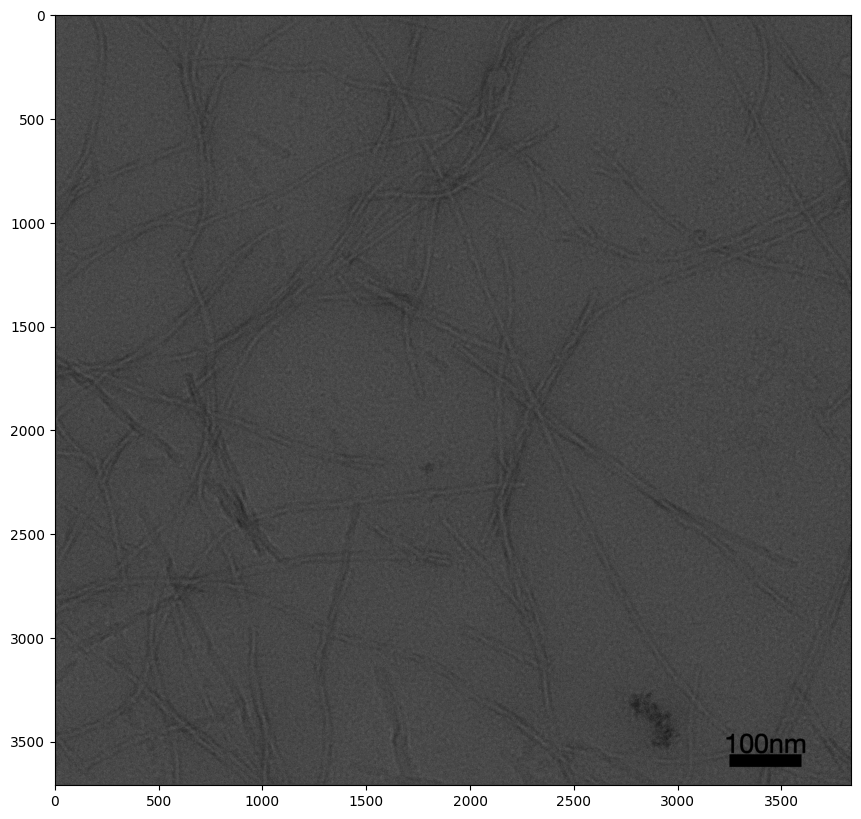

In [63]:
micrograph8bit=micrograph.convert_to_8bit()
micrograph8bit = micrograph8bit.make_scalebar()
micrograph8bit.imshow()

## Saving the image

The image can be easily saved from the micrograph object using the method write_image(). This can be used with no input at all, and will create an .jpg image named based on the original filename in the directory you are currently in. You can also specify the name of the output file by adding an input. 

Ending the name with .tif will save it as a tif file, this will by default be a 32-bit tif file unless you have previously converted the image to 8bit, and will have the pixel size included as a tag. 

You can specify a directory to output the files in with the keyword argument outdir='Directory'. This will create the new directory if it doesn't already exist. 

In [64]:
micrograph.write_image()

118.39792 15.252153
converting to 8bit
Fibrils_Example.jpg Done!


In [65]:
micrograph8bit.write_image('Tutorial_image.tif',outdir='images')

images/Tutorial_image_100nmscale.tif Done!


## Automating Pipelines

One big advantage of using python is how easy it is to automate repeat analysis with different files. This can be easily achived using a simple for loop:

Firstly collect the digital micrograph files (e.g. by using os.listdir to collect all the files in the directory, and list comprehension to find only the .dm* files):

In [66]:
dm_files = [x for x in os.listdir('.') if x[-4:-1]=='.dm']

Cy5.5_A5_0006.dm3
Cy5.5_A5_0006.dm3 opened as a Micrograph object


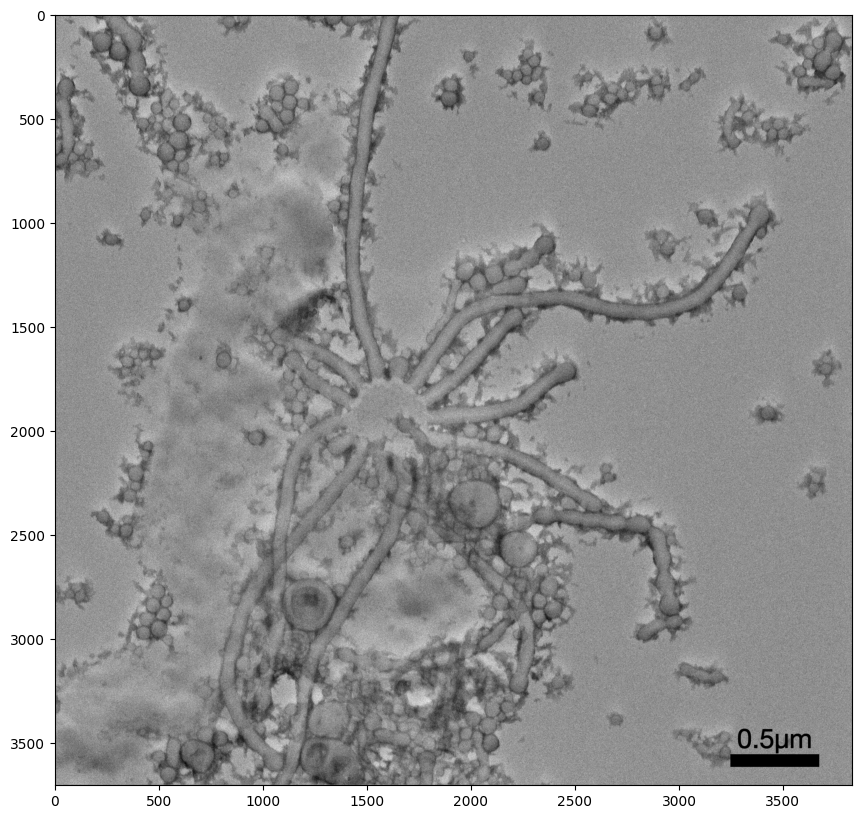

Example_image_0021.dm3
Example_image_0021.dm3 opened as a Micrograph object


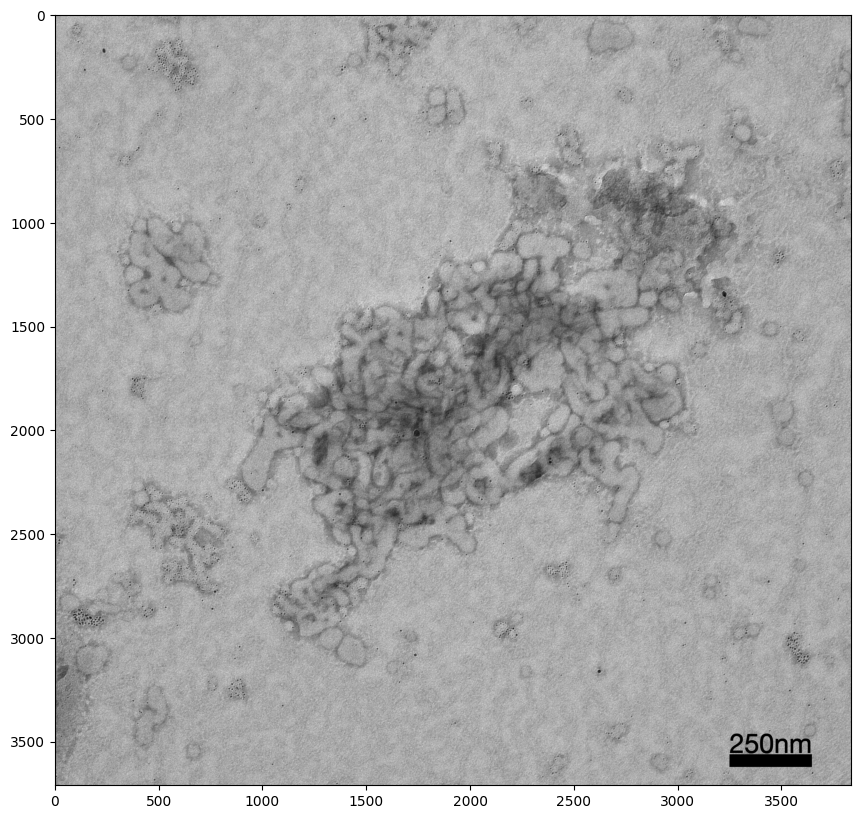

Fibrils_Example.dm3
Fibrils_Example.dm3 opened as a Micrograph object


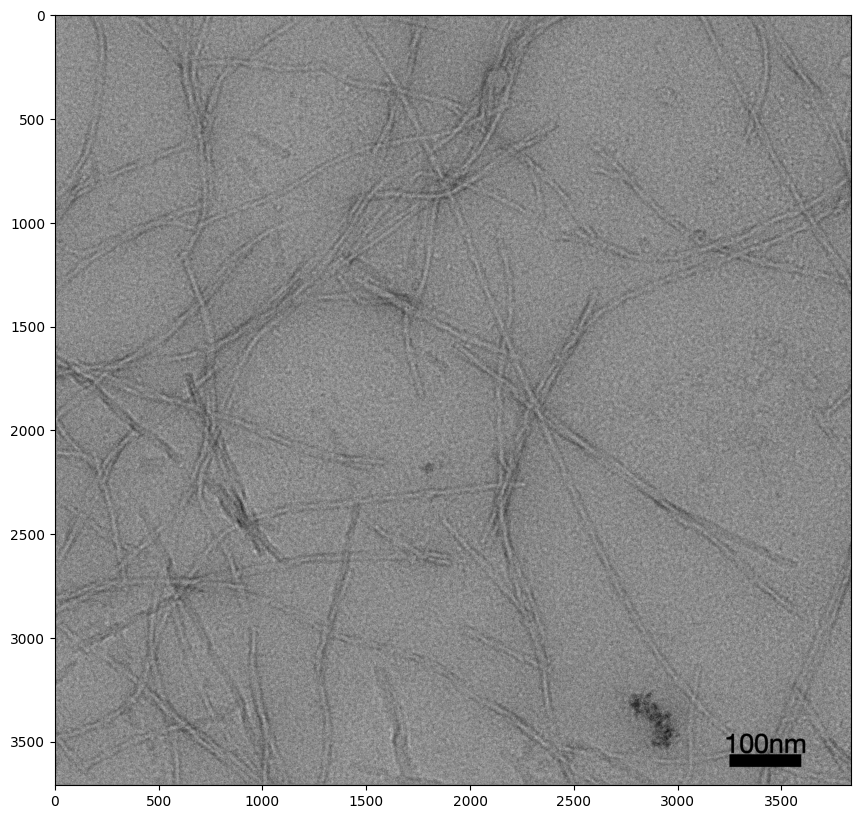

A1_Tribloc-100000X-0003.dm4
A1_Tribloc-100000X-0003.dm4 opened as a Micrograph object


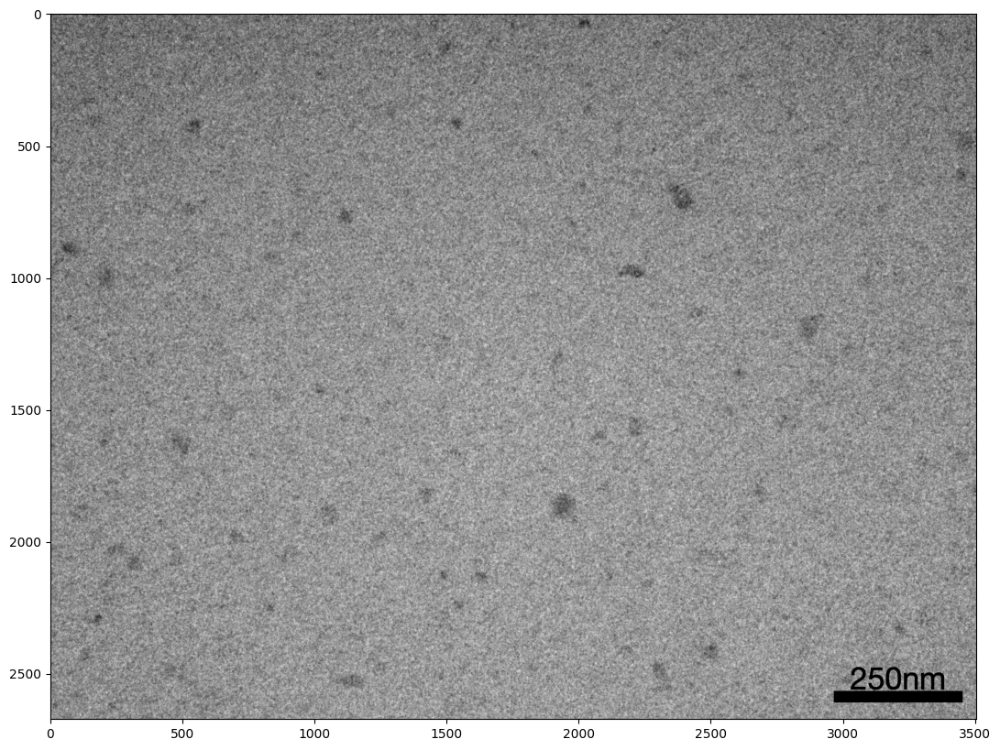

Old_fibril_oligomers_sample_unstained_0041.dm3
Old_fibril_oligomers_sample_unstained_0041.dm3 opened as a Micrograph object


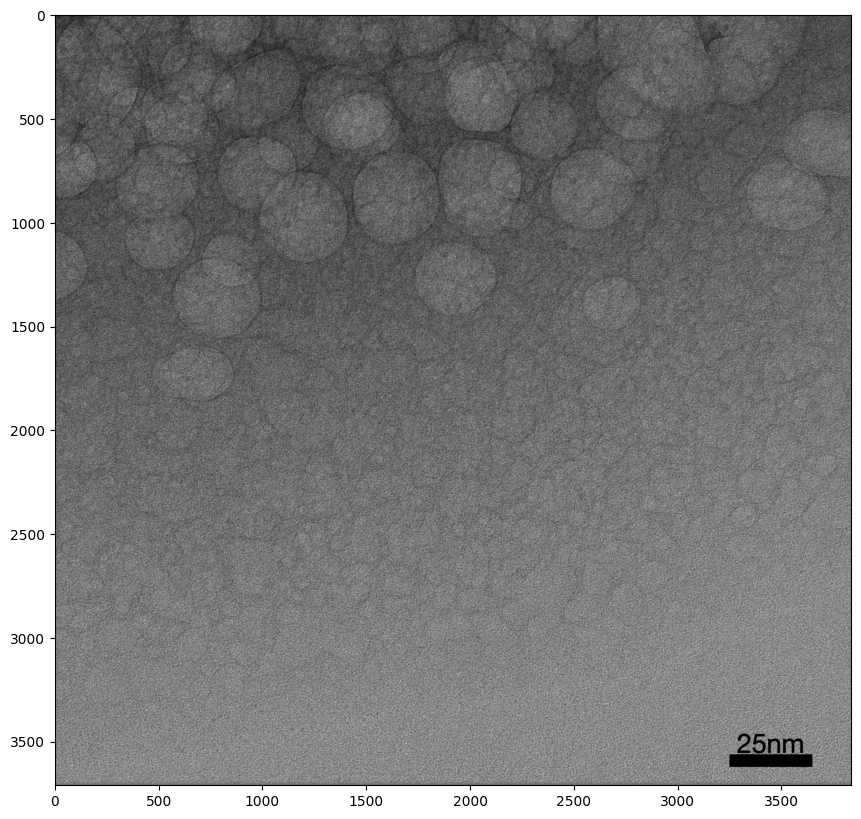

gold_growth_video_holder_test_070921.dm4
 is an image stack, averaging frames together, if you would open as a video, please us MicroVideo object
gold_growth_video_holder_test_070921.dm4 opened as a Micrograph object


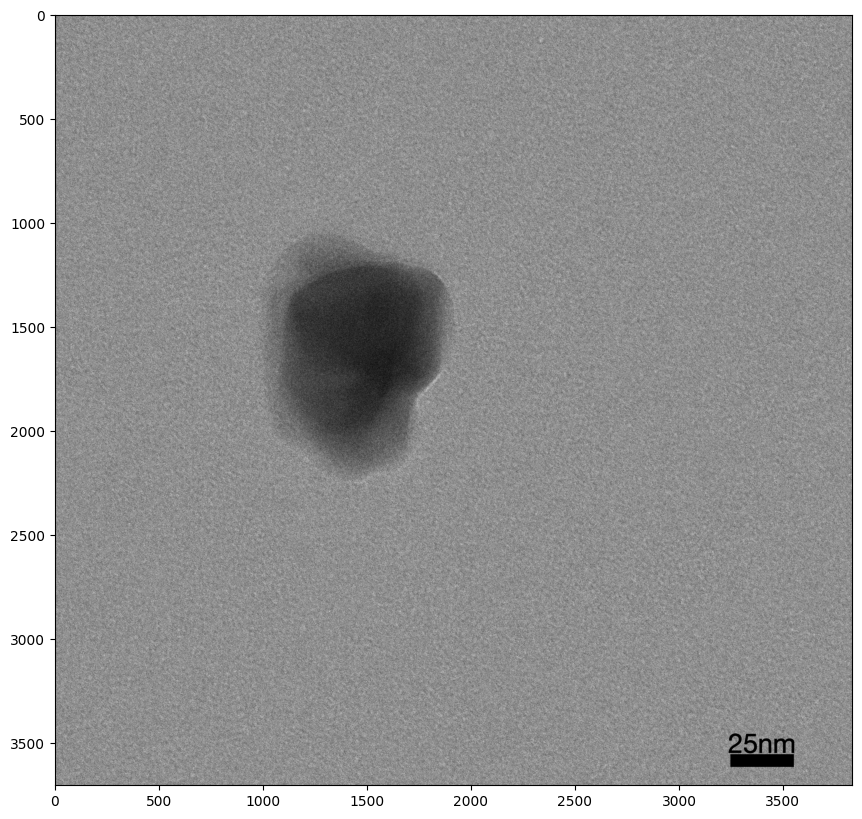

In [67]:
for file in dm_files:
    print(file)
    micrograph = Micrograph()
    micrograph.open_dm(file)
    micrograph = micrograph.median_filter()
    micrograph = micrograph.convert_to_8bit()
    micrograph = micrograph.make_scalebar()
    micrograph.imshow()

To make this even easier, I have included a function in the Micrograph_class.py file which will do this in a single function: 


In [68]:
for file in dm_files:
    default_image_pipeline(file) #There are more settings in this: medfilter=3, gaussfilter=0, scalebar=True, texton = True, xybin=2, color='Auto',**kwargs)

Cy5.5_A5_0006.dm3 opened as a Micrograph object
Saturation =  0.5
Maxmium value :  194.0
Minimum value :  63.0
./Images/Cy5.5_A5_0006_0.5umscale.jpg Done!
Example_image_0021.dm3 opened as a Micrograph object
Saturation =  0.5
Maxmium value :  202.0
Minimum value :  78.0
./Images/Example_image_0021_250nmscale.jpg Done!
Fibrils_Example.dm3 opened as a Micrograph object
Saturation =  0.5
Maxmium value :  190.0
Minimum value :  86.0
./Images/Fibrils_Example_100nmscale.jpg Done!
A1_Tribloc-100000X-0003.dm4 opened as a Micrograph object
Saturation =  0.5
Maxmium value :  199.0
Minimum value :  75.0
./Images/A1_Tribloc-100000X-0003_250nmscale.jpg Done!
Old_fibril_oligomers_sample_unstained_0041.dm3 opened as a Micrograph object
Saturation =  0.5
Maxmium value :  190.0
Minimum value :  51.0
./Images/Old_fibril_oligomers_sample_unstained_0041_25nmscale.jpg Done!
 is an image stack, averaging frames together, if you would open as a video, please us MicroVideo object
gold_growth_video_holder_test

## Getting more information

Need help? You can always try the help() method, this shows the details of the function as annotated:

In [69]:
help(micrograph)

Help on Micrograph in module SimpliPyTEM.Micrograph_class object:

class Micrograph(builtins.object)
 |  A class holding the micrograph image data along with associated parameters and methods. This makes processing microscope images easier as it collects data and methods into a single place. 
 |  The majority of image handling methods here comes from OpenCV, the functions often have more options/parameters, as a result making them both more powerful and more complicated. 
 |  This package aims to simplify and automate these functions, however if more functionality is required, I recommend using OpenCV (https://docs.opencv.org/4.x/) as a starting point for your image analysis. 
 |  ... 
 |  Attributes
 |  ----------
 |  filename:str
 |      The file name opened (blank if not opened in object)
 |  pixel_size:float
 |      The pixel size in the image, should be initialised when opening data assuming the pixel size is included, if not can easily be altered
 |  pixel_unit:str
 |      The un

In [70]:
help(micrograph.make_scalebar)

Help on method make_scalebar in module SimpliPyTEM.Micrograph_class:

make_scalebar(texton=True, color='Auto') method of SimpliPyTEM.Micrograph_class.Micrograph instance
    Automated method to create a scalebar of a suitable size, shape and color. Returns a new object with a scalebar. 
    The color will be selected between black and white based on mean value of the region of the scalebar compared to the mean value of the whole video. To override this the color can be defined as black white or grey.
    This will work best for 8-bit images, as the scalebar will be given values of 0 or 255. 
    
    Parameters
    ----------
    
        color : str
            The color of the scalebar, the options are 'white'. 'black' or 'grey'
        texton : bool
            Text can be turned off using texton=False, the selected size of the scalebar can be accessed using micrograph.scalebar_size
    
    Returns
    -------
        Micrograph_object_with_scalebar: Micrograph
            Copy of 

In [71]:
help(micrograph.gaussian_filter)

Help on method gaussian_filter in module SimpliPyTEM.Micrograph_class:

gaussian_filter(kernal=3) method of SimpliPyTEM.Micrograph_class.Micrograph instance
    Returns a Gaussian filtered copy of the micrograph object, kernal size defined in the call (default is 3)
    
        Parameters
        ----------
            n:int
                The n x n kernal for median filter is defined here, *must be an odd integer*
    
        Returns
        -------
            Gaussian_filtered_object :Micrograph
                Gaussian filtered copy of micrograph object with gaussian filtered image



## Advanced Functions 
### 2D Fourier transforms

A 2D fourier transform (FT) of a TEM image can be useful for a number of reasons: 
    - Lattace lines or periodic features can be detected and measured
    - Defocus can be evaluated and estimated from the Thon rings 
    - The resolution of images can be estimated
    
Displaying 2D fast-fourier transforms of images using SimpliPyTEM's Micrograph class is very simple, making use of several numpy functions: 



In [72]:
#Lets start again with a new object
micrograph = Micrograph()
micrograph.open_dm('Fibrils_Example.dm3')

Fibrils_Example.dm3 opened as a Micrograph object


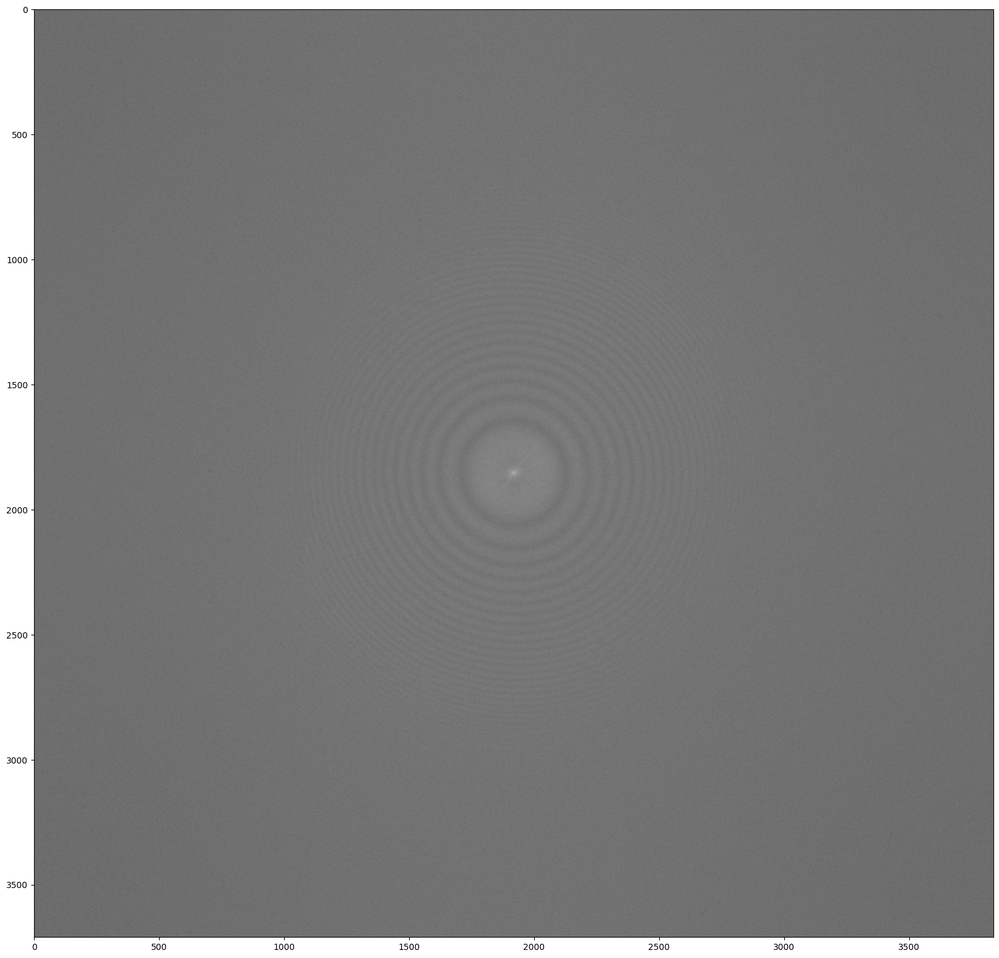

In [73]:
micrograph.display_fft()

Here we can see the Thon rings, which can be used to estimate defocus. We can simply change the minimum and maximum values displayed using the `vmax` and `vmin` parameters. 

We can also visualise the image alongside setting the `sidebyside` to `True` parameter

However to allow better control we can use the `ret` parameter, this is short for return and if set to `True`, a new micrograph object will be created with the powerspectrum as as the image. This allows plotting of a histogram, contrast enhancement and all the other functions that are usually available. 



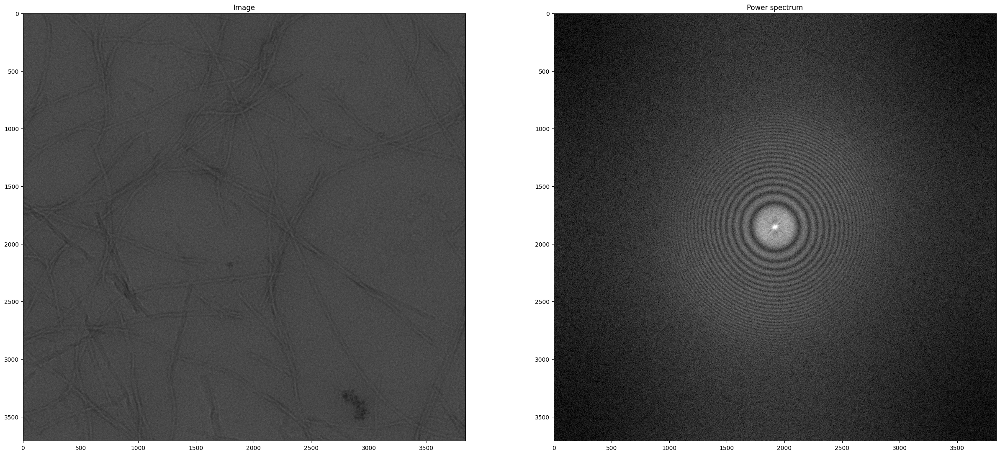

In [74]:
#Changing vmaax and vmin, and plotting side by side
micrograph.display_fft(vmax=12, vmin=9, sidebyside=True)

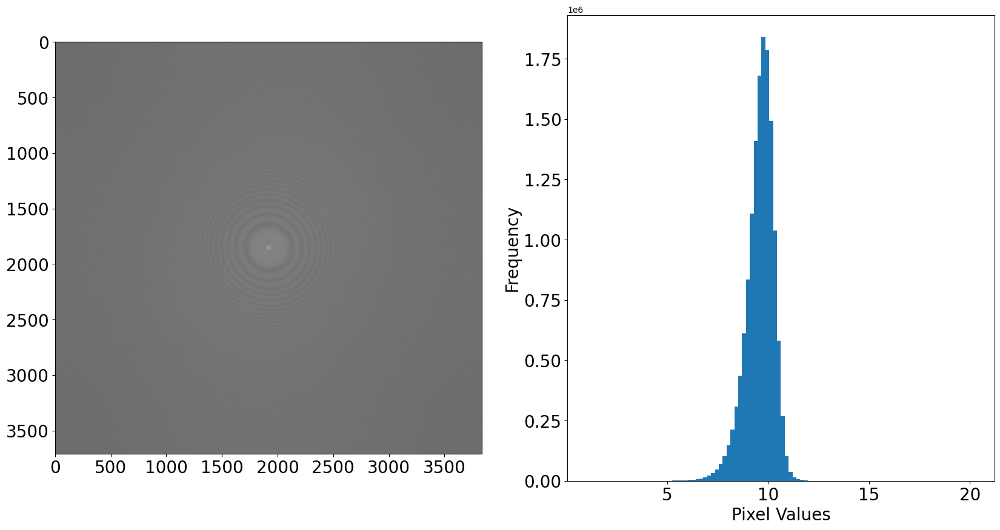

In [75]:
##Returning the fft as a new object
fft_ob = micrograph.display_fft(ret=True)
fft_ob.plot_histogram(sidebyside=True)

### Fixing uneven contrast

In TEM, image contrast often varies across the image, maybe due to an imperfectedly aligned microscope, leading to a brighter center and darker corners. This effect can prove problematic for downstream processing, like choosing particles by simple thresholding, and therefore in many cases should be corrected. 

Here present a method called 'Local_normalisation' to even out contrast throughout the image. This method works by first splitting the  image into patches. These patches are then multiplied by the (image-median / patch-median), leading all the patches to have the same median. The number of patches in each row/column is given when calling the function, such that an n=6 gives 6x6 or 36 patches. 


In [7]:
# Using a new micrograph with uneven contrast

micrograph = Micrograph('Old_fibril_oligomers_sample_unstained_0041.dm3')


Old_fibril_oligomers_sample_unstained_0041.dm3 opened as a Micrograph object


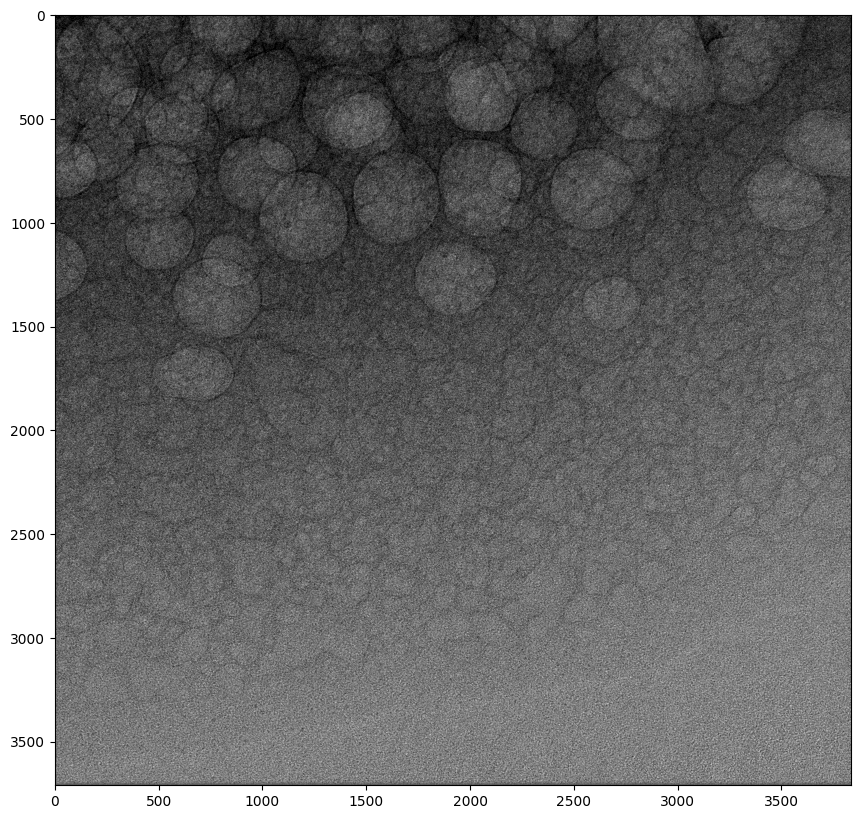

In [77]:
micrograph=micrograph.convert_to_8bit()
micrograph.imshow(vmin=50, vmax=150)

Here we see the corners are darker than the center. If we were to try to select the particles by thresholding, it would be difficult to use a single threshold value to select all the particles because the contrast is so uneven:

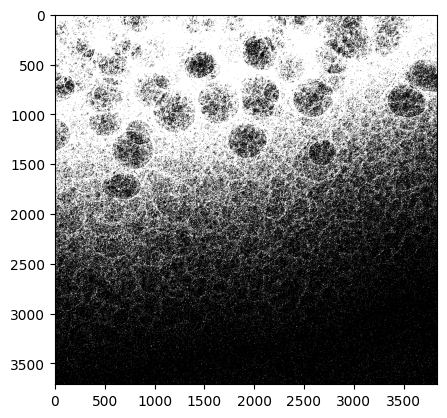

In [78]:
from SimpliPyTEM.Particle_analysis import Threshold
#help(Threshold)
thresh = Threshold(micrograph.image, 80)
plt.imshow(thresh)

See? This threshold is good for particles in the center, but it catches the entirity of the top corners, making it impossible to use here. Lets try running local_normalisation to get this looking a bit better:

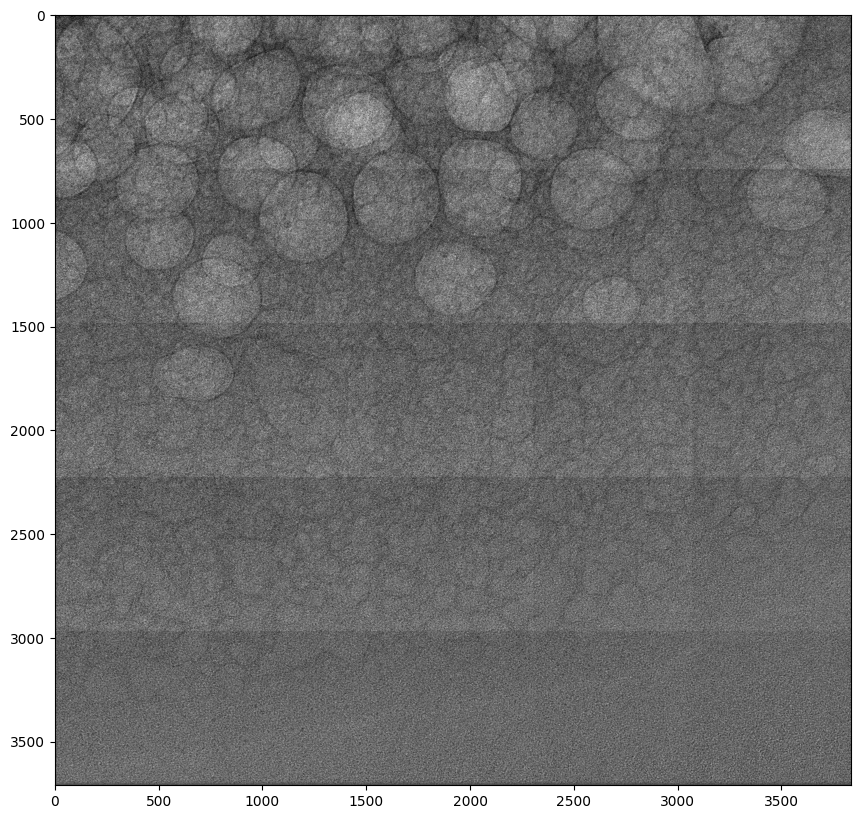

In [79]:
micrographLN  = micrograph.local_normalisation(5)
micrographLN.imshow(vmin=40,vmax=150)

So the contrast is looking better! There is a clear patchwork effect that we can deal with in a minute, but at least it is more even now, this can help us threshold as follows: 

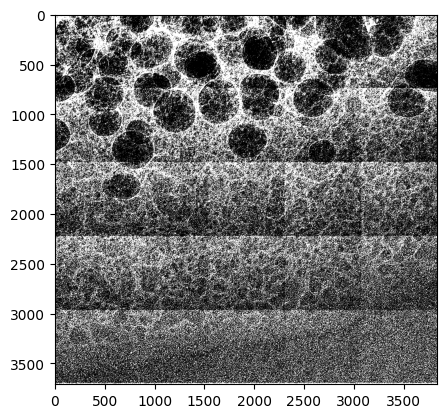

In [80]:
thresh_norm = Threshold(micrographLN.image, 80)
plt.imshow(thresh_norm)

Much better! 

Now, can we get rid of the patchwork effect by 'padding' the patches, meaning there is an overlap which is dealt with separately. This can massively improve how the results look. 

To use padding, set `pad=True`, there is also a parameter called `padding` to set the percentage overlap between images, this is 15% by default but can be adjusted as desired.

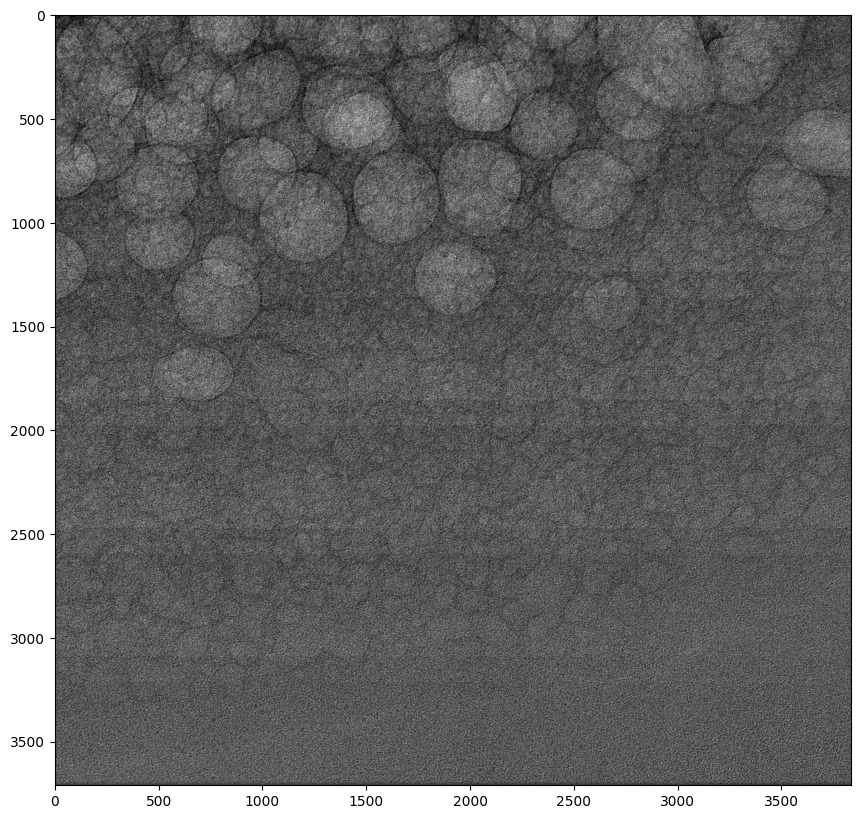

In [81]:
micrographLN  = micrograph.local_normalisation(6, pad=True, padding=20)
micrographLN.imshow(vmin=50, vmax=150)

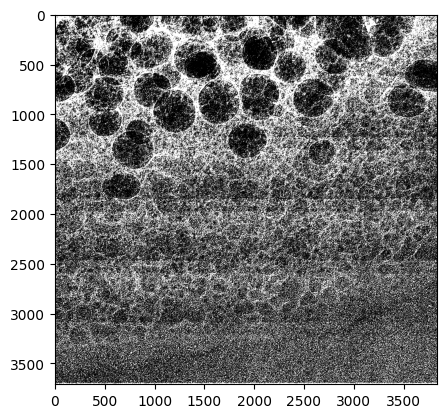

In [82]:
thresh_norm = Threshold(micrographLN.image, 80)
plt.imshow(thresh_norm)

Took its time, but you can barely see the edge artefacts and the result still looks good! 

### Using Topaz denoising

Topaz (https://doi.org/10.1038/s41467-020-18952-1) is a neural network based denoising method which is trained on cryo-EM data. This method is very effective at enhancing contrast and making low resultion features more obvious. It can be hard to know whether the high resolution data produced is accurate, so use with care, but it is an incredibly useful process to use for noisy datasets. 

There are a bunch of parameters which are best described in the topaz documentation, but can be used simply here (just pass them into `micrograph.topaz_denoise()`). The two most important parameters are: 

   `model` - which model to use, the options are 'unet', 'unet-small', 'fcnn', 'affine', 'unet-v0.2.1', details of this are available on topaz's tutorial (https://github.com/tbepler/topaz) 
    
   `use_cuda` - Use CUDA GPU? this is only possible if you have one but will dramatically increase the processing speed, worth using if available! It increased processing speed ten-fold on my computer. 
  
  
You can just run with the defaults though, like here:
  

In [14]:
micrograph = Micrograph('Fibrils_example.dm3')
micrograph_topaz = micrograph.topaz_denoise()

In [ ]:
micrograph.show_pair(micrograph_topaz)

In [21]:
micrograph = micrograph.gaussian_filter()
micrograph= micrograph.clip_contrast()

Saturation =  0.2
Maxmium value :  172.0
Minimum value :  70.0


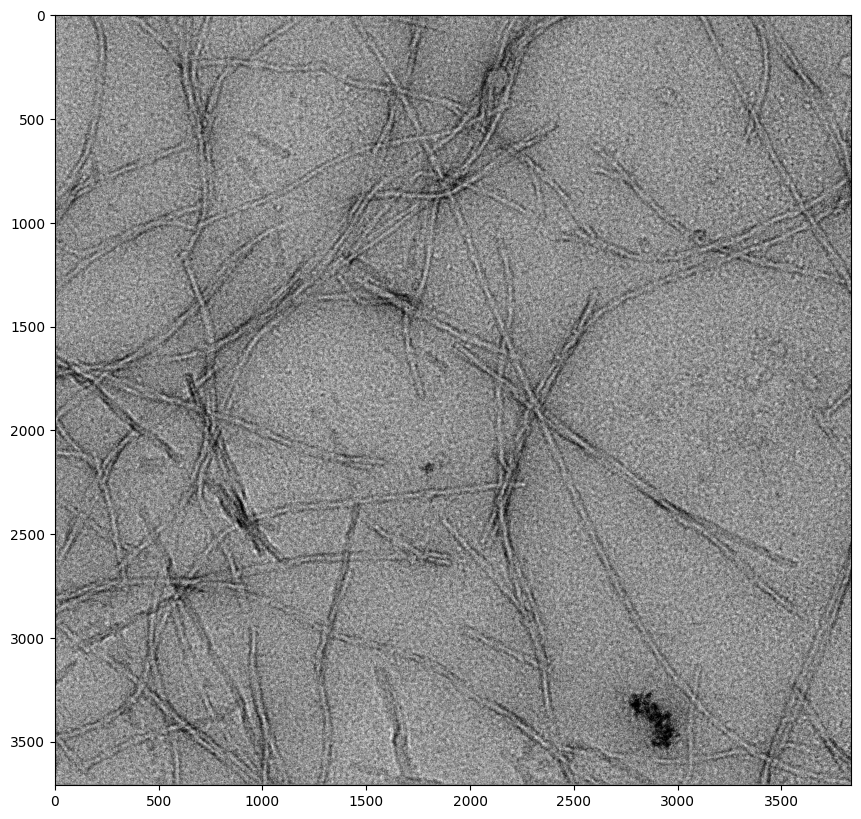

In [ ]:
micrograph.imshow()

Lets zoom in to see the real effect! 

Here I am creating two subplots, and then plotting two crops using index splicing. 

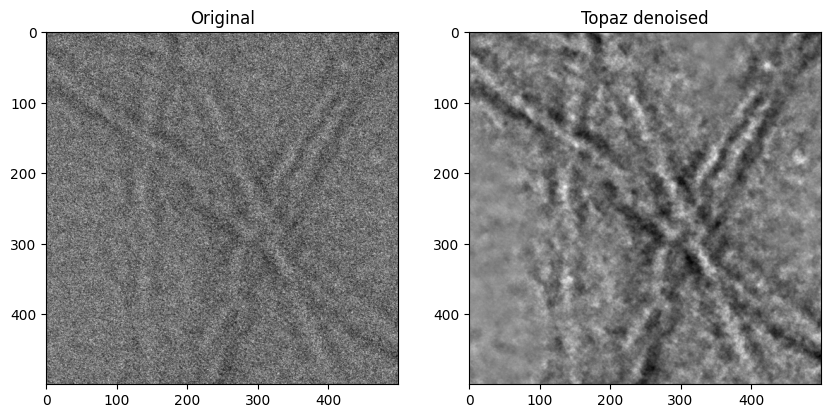

In [20]:
fig, ax = plt.subplots(1,2, figsize=(10,5))
ax[0].imshow(micrograph.image[1600:2100, 2000:2500])
ax[0].set_title('Original')
ax[1].imshow(micrograph_topaz.image[1600:2100, 2000:2500])
ax[1].set_title('Topaz denoised')
plt.show()

## Any more questions? 
Try raising an issue on github, or email me (Gabriel Ing) at ucbtgrb@ucl.ac.uk for more help! 